In [1]:
from collections import Counter
import glob
import itertools
from itertools import izip
import os

from IPython.core.display import HTML, Image
from matplotlib import gridspec
import matplotlib.pyplot as plt
from matplotlib_venn import venn3, venn2
import numpy as np
import pandas as pd
import scipy
import seaborn as sns
from scipy.stats import hypergeom
from scipy.stats import ks_2samp

import flotilla
from gscripts.general import dataviz
from gscripts.general import parsers
from gscripts.general import region_helpers
from gscripts.rnaseq import helpers
from gscripts import GO
from gscripts import miso

img_dir = "/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/"

:0: FutureWarning: IPython widgets are experimental and may change in the future.


In [2]:
datasets = ["fus", 'taf15', 'tdp43', 'fus_taf15', 'taf15_tdp43', 'R521G', 'T198C',]
rbp_colors = dict(zip(datasets, sns.color_palette("bright", len(datasets))))


rbp_colors = {"fus": '#43A247',
             "FUS": '#43A247',
             'taf15': '#DB1D3D',
             'TAF15': '#DB1D3D',
             'tdp43': '#712878',
             'TDP43': '#712878',
             'fus_taf15': 'y',
             'taf15_tdp43': 'k',
             'R521G': 'c', 
             'T198C': 'c',
             'EWS' : 'g',
             'ctrl': (0.90311419262605563, 0.54185316071790801, 0.76495195557089413)}


rbp_names = {"fus": 'FUS',
              'taf15': 'TAF15',
              'tdp43': 'TDP43',
              'fus_taf15': 'FUS TAF15',
              'taf15_tdp43': 'TAF15 TDP43'}

In [3]:
def counts_to_rpkm(featureCountsTable):
    counts = featureCountsTable.ix[:,5:]
    lengths = featureCountsTable['Length']
    mapped_reads = counts.sum()
    return (counts * pow(10,9)).div(mapped_reads, axis=1).div(lengths, axis=0)

def gencode_to_ensembl(gene_list):
    for gene in gene_list:
        yield gene.split(".")[0]

In [4]:
gene_id_to_name = region_helpers.gene_id_to_name("/nas3/gpratt/gencode/gencode.v17.annotation.gtf.db")
gene_id_to_type = region_helpers.gene_id_to_type("/nas3/gpratt/gencode/gencode.v17.annotation.gtf.db")

name_to_gene_id = {value: key for key, value in gene_id_to_name.items()}

hg19_gene_id_to_name = region_helpers.gene_id_to_name("/nas3/gpratt/gencode/gencode.v17.annotation.gtf.db")
mm9_gene_id_to_name = region_helpers.gene_id_to_name("/nas3/gpratt/gencode/gencode.vM1.annotation.gtf.db")

pd.Series(mm9_gene_id_to_name).to_csv("/nas3/gpratt/Dropbox/ENCORE-YEOLAB/data/localization/mm9_gene_id.csv")
pd.Series(hg19_gene_id_to_name).to_csv("/nas3/gpratt/Dropbox/ENCORE-YEOLAB/data/localization/hg19_gene_id.csv")

#Make MN Study in flotilla

In [5]:
human_mn_splicing = pd.read_csv("/nas3/gpratt/projects/fet_family/analysis/human_mn_v1/miso_summary_filtered.csv", 
                                index_col=[18, 2])
human_mn_splicing = human_mn_splicing[[splice not in ["ALE", "AFE"] for splice in human_mn_splicing.splice_type]]

splicing_matrix = human_mn_splicing.miso_posterior_mean.unstack()

#Load all Counts / Generate RPKM's

In [6]:
#MN
mn_counts = pd.read_table("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/all_counts.txt", skiprows=1, index_col=0)
mn_counts.columns = [os.path.basename(item).split(".")[0] for item in mn_counts.columns]
mn_rpkm = helpers.counts_to_rpkm(mn_counts).T
mn_flotilla_rpkm = mn_rpkm.copy()

mn_metadata = pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/sampleInfo.csv", index_col=0)
result = []
for name, item in mn_metadata.iterrows():
    result.append(item.values)
mn_rpkm.index = pd.MultiIndex.from_tuples(result, names=item.index)

#NPC
npc_counts = pd.read_table("/nas3/gpratt/Dropbox/TAF15/Data/human_npc/all_counts.txt", skiprows=1, index_col=0)
npc_counts.columns = [os.path.basename(item).split(".")[0] for item in npc_counts.columns]

npc_rpkm = helpers.counts_to_rpkm(npc_counts).T
npc_flotilla_rpkm = npc_rpkm.copy()

npc_metadata = pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/human_npc/sampleInfo.csv", index_col=0)
result = []
for name, item in npc_metadata.iterrows():
    result.append(item.values)
npc_rpkm.index = pd.MultiIndex.from_tuples(result, names=item.index)

rpkm = pd.concat([mn_rpkm, npc_rpkm])

In [7]:
#Rename stuff to work with flotilla
mn_metadata = mn_metadata.rename(columns={"knockdown": "phenotype"})
npc_metadata = npc_metadata.rename(columns={"knockdown": "phenotype"})

mn_flotilla_rpkm.columns = [gene_id.split(".")[0] for gene_id in mn_flotilla_rpkm.columns]
mn_flotilla_rpkm.index = [gene_id.split(".")[0] for gene_id in mn_flotilla_rpkm.index]

npc_flotilla_rpkm.columns = [col.split(".")[0] for col in npc_flotilla_rpkm.columns]
npc_flotilla_rpkm.index = [col.split(".")[0] for col in npc_flotilla_rpkm.index]

In [8]:
mn_study = flotilla.Study(# The metadata describing phenotype and pooled samples
                       mn_metadata,
                       # A version for this data
                       version='0.1.0',
                       expression_data = mn_flotilla_rpkm,
                       # Dataframe of the splicing data
                       splicing_data=splicing_matrix,
                       expression_thresh = 1,
                       species="hg19"
)

mn_subset_study = flotilla.Study(# The metadata describing phenotype and pooled samples
                       mn_metadata[mn_metadata.phenotype.isin(["FUS", "TAF15", "TDP43"])],
                       version='0.1.0',
                       expression_data = mn_flotilla_rpkm[mn_metadata.phenotype.isin(["FUS", "TAF15", "TDP43"])],
                       expression_thresh = 1,
                       species="hg19"
)

npc_study = flotilla.Study(# The metadata describing phenotype and pooled samples
                       npc_metadata,
                       version='0.1.0',
                       expression_data = npc_flotilla_rpkm,
                       expression_thresh = 1,
                       species="hg19"
)

npc_subset_study = flotilla.Study(# The metadata describing phenotype and pooled samples
                       npc_metadata[npc_metadata.phenotype.isin(["FUS", "TAF15", "TDP43"])],
                       version='0.1.0',
                       expression_data = npc_flotilla_rpkm[npc_metadata.phenotype.isin(["FUS", "TAF15", "TDP43"])],
                       expression_thresh = 1,
                       species="hg19"
)

2015-08-03 15:50:16	Initializing Study
2015-08-03 15:50:16	Initializing Predictor configuration manager for Study
2015-08-03 15:50:16	Predictor ExtraTreesClassifier is of type <class 'sklearn.ensemble.forest.ExtraTreesClassifier'>
2015-08-03 15:50:16	Added ExtraTreesClassifier to default predictors
2015-08-03 15:50:16	Predictor ExtraTreesRegressor is of type <class 'sklearn.ensemble.forest.ExtraTreesRegressor'>
2015-08-03 15:50:16	Added ExtraTreesRegressor to default predictors
2015-08-03 15:50:16	Predictor GradientBoostingClassifier is of type <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'>
2015-08-03 15:50:16	Added GradientBoostingClassifier to default predictors
2015-08-03 15:50:16	Predictor GradientBoostingRegressor is of type <class 'sklearn.ensemble.gradient_boosting.GradientBoostingRegressor'>
2015-08-03 15:50:16	Added GradientBoostingRegressor to default predictors
2015-08-03 15:50:16	Loading metadata
2015-08-03 15:50:16	Loading species metadata from ~/f

No phenotype to color mapping was provided, falling back on reasonable defaults.
No phenotype to marker (matplotlib plotting symbol) was provided, so each phenotype will be plotted as a circle in visualizations.
Error loading species hg19 data 

2015-08-03 15:50:34	Loading expression data
2015-08-03 15:50:34	Initializing expression
2015-08-03 15:50:34	Done initializing expression
2015-08-03 15:50:36	Loading splicing data
2015-08-03 15:50:36	Initializing splicing
2015-08-03 15:50:36	Done initializing splicing
2015-08-03 15:50:36	Successfully initialized a Study object!
2015-08-03 15:50:37	Initializing Study
2015-08-03 15:50:37	Initializing Predictor configuration manager for Study
2015-08-03 15:50:37	Predictor ExtraTreesClassifier is of type <class 'sklearn.ensemble.forest.ExtraTreesClassifier'>
2015-08-03 15:50:37	Added ExtraTreesClassifier to default predictors
2015-08-03 15:50:37	Predictor ExtraTreesRegressor is of type <class 'sklearn.ensemble.forest.ExtraTreesRegressor'>
2015-08-03 15:50:37	Added ExtraTreesRegressor to default predictors
2015-08-03 15:50:37	Predictor GradientBoostingClassifier is of type <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'>
2015-08-03 15:50:37	Added GradientBoostingClassi

/nas3/gpratt/anaconda/lib/python2.7/site-packages/pandas/core/frame.py:1825: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  "DataFrame index.", UserWarning)
No phenotype to color mapping was provided, falling back on reasonable defaults.
No phenotype to marker (matplotlib plotting symbol) was provided, so each phenotype will be plotted as a circle in visualizations.
Error loading species hg19 data 

2015-08-03 15:50:48	Loading expression data
2015-08-03 15:50:48	Initializing expression
2015-08-03 15:50:48	Done initializing expression
2015-08-03 15:50:51	Successfully initialized a Study object!
2015-08-03 15:50:51	Initializing Study
2015-08-03 15:50:51	Initializing Predictor configuration manager for Study
2015-08-03 15:50:51	Predictor ExtraTreesClassifier is of type <class 'sklearn.ensemble.forest.ExtraTreesClassifier'>
2015-08-03 15:50:51	Added ExtraTreesClassifier to default predictors
2015-08-03 15:50:51	Predictor ExtraTreesRegressor is of type <class 'sklearn.ensemble.forest.ExtraTreesRegressor'>
2015-08-03 15:50:51	Added ExtraTreesRegressor to default predictors
2015-08-03 15:50:51	Predictor GradientBoostingClassifier is of type <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'>
2015-08-03 15:50:51	Added GradientBoostingClassifier to default predictors
2015-08-03 15:50:51	Predictor GradientBoostingRegressor is of type <class 'sklearn.ensemble.gradient_boo

No phenotype to color mapping was provided, falling back on reasonable defaults.
No phenotype to marker (matplotlib plotting symbol) was provided, so each phenotype will be plotted as a circle in visualizations.
Error loading species hg19 data 

2015-08-03 15:51:03	Loading expression data
2015-08-03 15:51:03	Initializing expression
2015-08-03 15:51:03	Done initializing expression
2015-08-03 15:51:05	Successfully initialized a Study object!
2015-08-03 15:51:05	Initializing Study
2015-08-03 15:51:05	Initializing Predictor configuration manager for Study
2015-08-03 15:51:05	Predictor ExtraTreesClassifier is of type <class 'sklearn.ensemble.forest.ExtraTreesClassifier'>
2015-08-03 15:51:05	Added ExtraTreesClassifier to default predictors
2015-08-03 15:51:05	Predictor ExtraTreesRegressor is of type <class 'sklearn.ensemble.forest.ExtraTreesRegressor'>
2015-08-03 15:51:05	Added ExtraTreesRegressor to default predictors
2015-08-03 15:51:05	Predictor GradientBoostingClassifier is of type <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'>
2015-08-03 15:51:05	Added GradientBoostingClassifier to default predictors
2015-08-03 15:51:05	Predictor GradientBoostingRegressor is of type <class 'sklearn.ensemble.gradient_boo

No phenotype to color mapping was provided, falling back on reasonable defaults.
No phenotype to marker (matplotlib plotting symbol) was provided, so each phenotype will be plotted as a circle in visualizations.
Error loading species hg19 data 

2015-08-03 15:51:17	Loading expression data
2015-08-03 15:51:17	Initializing expression
2015-08-03 15:51:17	Done initializing expression
2015-08-03 15:51:20	Successfully initialized a Study object!


#Basic QC 
Correlations 
------------

In [9]:
def format_names(names):
    cell_type, exp, knockdown, rep = names
    return "{} {} KD rep {}".format(cell_type, knockdown, rep)

In [10]:
# num_rows = 4
# num_cols = 3
# with dataviz.Figure(os.path.join(img_dir, "replicate_plotting.svg"), figsize=(1.5 * num_cols, 1.5 * num_rows)) as fig:
#     max_combinations = np.max(rpkm.groupby(level=(["cell_type", "knockdown"])).count().values)
#     gs = gridspec.GridSpec(num_rows, num_cols)
#     count = 0
#     for x, (name, group) in enumerate(rpkm.groupby(level=(["cell_type", "knockdown"]))):
#         for y, (name1, name2) in enumerate(itertools.combinations(group.index, 2)):

#             x = count / 3
#             y = count % 3

#             ax = fig.add_subplot(gs[x,y]) 
#             series1 = rpkm.ix[name1]
#             series2 = rpkm.ix[name2]

#             dataviz.loglog_hist2d(series1, series2, ax=ax)
#             sns.despine(ax=ax)
            

#             formatted_name1 = format_names(name1)
#             formatted_name2 = format_names(name2)
            
#             ax.set_xlabel(formatted_name1, fontsize=6)
#             ax.set_ylabel(formatted_name1, fontsize=6)            
#             r2 = scipy.stats.linregress(series1, series2)[2]
#             ax.text(2, 3, "$R^2$={:.2f}".format(r2), fontsize=6)
#             #ax.set_title("{}\nvs\n{}".format(formatted_name1, formatted_name2), fontsize=10)
#             [tick.set_fontsize(6) for tick in ax.get_xticklabels()]
#             [tick.set_fontsize(6) for tick in ax.get_yticklabels()]
#             count += 1

Figure Legend: Correlation between technical Replicates for MN and NPC and their knockdowns of FUS, TAF15, TDP43 and the double TAF15/TDP43 and TAF15/FUS knockdowns

#Check Knockdowns

In [11]:
mn_study.expression.data[[mn_study.expression.maybe_renamed_to_feature_id("FUS")[0],
                      mn_study.expression.maybe_renamed_to_feature_id("TAF15")[0],
                      mn_study.expression.maybe_renamed_to_feature_id("TARDBP")[0]]]

,ENSG00000089280,ENSG00000172660,ENSG00000120948
FUS_shRNA_1,2.793034,7.178087,28.663085
FUS_shRNA_2,2.640107,6.659736,28.532364
FUS_TAF15_shRNA_1,3.407149,4.355524,26.316867
FUS_TAF15_shRNA_2,2.751437,4.265410,29.316705
Scrm_1,6.424281,6.560036,26.879956
Scrm_2,7.242226,6.936004,26.182758
TAF15_shRNA_1,6.691984,2.556731,27.370291
TAF15_shRNA_2,6.491468,2.370395,27.875746
TAF15_TDP43_shRNA_1,6.182758,5.714977,12.567875
TAF15_TDP43_shRNA_2,7.148412,5.893919,13.453078


In [12]:
npc_study.expression.data[[npc_study.expression.maybe_renamed_to_feature_id("FUS")[0],
                      npc_study.expression.maybe_renamed_to_feature_id("TAF15")[0],
                      npc_study.expression.maybe_renamed_to_feature_id("TARDBP")[0]]]

,ENSG00000089280,ENSG00000172660,ENSG00000120948
NPC_FUS_1_p7_35,19.085010,39.579364,40.324690
NPC_FUS_2_p7_44,17.882191,66.548483,67.592412
NPC_Scrm_1_p7_35,84.468844,54.080171,61.716993
NPC_Scrm_2_p7_44,74.519081,40.183723,69.131202
NPC_TAF15_1_p7_35,98.721287,12.973605,60.302487
NPC_TAF15_2_p7_44,103.935100,12.386852,64.809201
NPC_TDP43_1_p_44,55.742206,36.700331,31.723241
NPC_T+F_1_p7_44,26.403299,12.486408,62.746433
NPC_T+F_2_p7_44,29.753210,14.237639,59.996021
NPC_T+T_1_p7_44,63.695818,10.721307,36.391138


#PCA

MN All Data
----

In [13]:
# dv = mn_study.plot_pca(feature_subset = "gene_type: protein_coding")
# dv.reduced_fig.savefig(os.path.join(img_dir, "mn_qc_pca.pdf"))
# dv.reduced_fig.savefig(os.path.join(img_dir, "mn_qc_pca.svg"))

Figure Legend: PCA of just protein coding genes for MNs for all knockdowns and double knockdowns

MN Only FUS TAF15 and TDP43 KD
-----

In [14]:
# dv = mn_subset_study.plot_pca(feature_subset = "gene_type: protein_coding")
# dv.reduced_fig.savefig(os.path.join(img_dir, "mn_subset_qc_pca.pdf"))
# dv.reduced_fig.savefig(os.path.join(img_dir, "mn_subset_qc_pca.svg"))

Figure Legend: PCA of just protein coding genes in MNs for only single knockdowns of TAF15, FUS and TDP43

#NPC All Data

In [15]:
# dv = npc_study.plot_pca(feature_subset = "gene_type: protein_coding")
# dv.reduced_fig.savefig(os.path.join(img_dir, "npc_qc_pca.svg"))
# dv.reduced_fig.savefig(os.path.join(img_dir, "npc_qc_pca.pdf"))

Figure Legend: PCA of just protein coding genes for NPC for all knockdowns and double knockdowns

NPC Only FUS TAF15 and TDP43 KD
------

In [16]:
# dv = npc_subset_study.plot_pca(feature_subset = "gene_type: protein_coding")
# dv.reduced_fig.savefig(os.path.join(img_dir, "npc_subset_qc_pca.svg"))
# dv.reduced_fig.savefig(os.path.join(img_dir, "npc_subset_qc_pca.pdf"))

Figure Legend: PCA of just protein coding genes in MNs for only single knockdowns of TAF15, FUS and TDP43

#Get List of Expressed Genes

In [17]:
scramble_controls = rpkm.xs("Scrm", level="knockdown")

mn_scrable_controls = scramble_controls.ix['MN']
npc_scramble_controls = scramble_controls.ix['NPC']

expressed_genes = {"mn" : list(gencode_to_ensembl(mn_scrable_controls[mn_scrable_controls > 1].dropna(axis=1).columns)),
                 "npc": list(gencode_to_ensembl(npc_scramble_controls[npc_scramble_controls > 1].dropna(axis=1).columns)) }

In [18]:
# with dataviz.Figure(os.path.join(img_dir, "overlapping_expressed_genes.svg"), figsize=(10, 10)) as fig:
#     ax = fig.add_subplot(2,2,1)
#     venn2([set(expressed_genes['mn']), set(expressed_genes['npc'])], 
#           set_labels=["MN", "NPC"], ax=ax)

#     ax.set_title("Overlapping Expressed Genes")

Figure Legend: Overlap of Expressed Genes in MN and NPC

#Knockdown Analysis

In [19]:
result = {
    "fus": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/fus_only.csv", index_col=0),
    "taf15": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/taf15_only.csv", index_col=0),
    "tdp43": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/tdp43_only.csv", index_col=0),
    "taf15_tdp43": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/taf15_tdp43_only.csv", index_col=0),
    "fus_taf15": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/fus_taf15_only.csv", index_col=0),
}

mn = pd.concat(result, names=['rbp', 'gene'])

result = {
    "fus": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/human_npc/deseq/fus_only.csv", index_col=0),
    "taf15": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/human_npc/deseq/taf15_only.csv", index_col=0),
    "tdp43": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/human_npc/deseq/tdp43_only.csv", index_col=0),
    "taf15_tdp43": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/human_npc/deseq/taf15_tdp43_only.csv", index_col=0),
    "fus_taf15": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/human_npc/deseq/fus_taf15_only.csv", index_col=0),
}

npc = pd.concat(result, names=['rbp', 'gene'])

knockdowns = pd.concat({"npc": npc, "mn": mn}, names=['cell_type', 'rbp', 'gene'])
knockdowns["gene_name"] = [gene_id_to_name[item] for item in knockdowns.index.get_level_values("gene")]

iPCS MN Differentation Knockdowns
-----

In [20]:
cashe = {'G298S': 'tdp', 'N352S': 'tdp', 'R521G': 'fus', 'T198C': 'fus'}

ips_knockdowns = pd.concat({os.path.basename(rbp).split(".")[0]: pd.read_csv(rbp, index_col=0) for rbp in glob.glob("/nas3/gpratt/Dropbox/TAF15/Data/anthony_rnaseq/deseq/*")})
ips_knockdowns['gene_names'] = [gene_id_to_name[gene_id] for gene_id in ips_knockdowns.index.get_level_values(level=1)]

results = []
for item in ips_knockdowns.index:
    gene_id = item[1]
    mutation = item[0].upper()
    rbp = cashe[mutation]
    
    results.append([mutation, rbp, gene_id])
    
ips_knockdowns.index = pd.MultiIndex.from_tuples(results, names=["rbp", 'mutation', "gene"])
ips_knockdowns = ips_knockdowns.sortlevel()

In [21]:
ips_significant_knockdowns = ips_knockdowns[(ips_knockdowns.padj <= .05) & (abs(ips_knockdowns.log2FoldChange) > 1)]
ips_signifcant_upregulated = ips_significant_knockdowns[ips_significant_knockdowns.log2FoldChange > 0]
ips_signifcant_downregulated = ips_significant_knockdowns[ips_significant_knockdowns.log2FoldChange < 0]

#Check Differental Expression is Changing as we expect

In [22]:
target_rbp_knockdowns = pd.concat([knockdowns.ix[knockdowns.index.get_level_values("rbp").isin(["fus", "fus_taf15"])].xs(name_to_gene_id['FUS'], level="gene"),
                                   knockdowns.ix[knockdowns.index.get_level_values("rbp").isin(["taf15", "fus_taf15", "taf15_tdp43"])].xs(name_to_gene_id['TAF15'], level="gene"),
                                   knockdowns.ix[knockdowns.index.get_level_values("rbp").isin(["tdp43", "taf15_tdp43"])].xs(name_to_gene_id['TARDBP'], level="gene")])

target_rbp_knockdowns.sortlevel().drop(["lfcSE", "stat", "baseMean", "pvalue"], axis=1)

log2FoldChange          padj gene_name
cell_type rbp                                                
mn        fus               -1.344215  1.106161e-29       FUS
          fus_taf15         -1.196325  1.579696e-16       FUS
          fus_taf15         -0.692174  8.119795e-07     TAF15
          taf15             -1.465914  4.111641e-29     TAF15
          taf15_tdp43       -0.302955  3.172212e-02     TAF15
          taf15_tdp43       -1.110648  1.671064e-39    TARDBP
          tdp43             -1.438389  4.089340e-39    TARDBP
npc       fus               -1.688782  3.152947e-02       FUS
          fus_taf15         -1.547470  1.514233e-12       FUS
          fus_taf15         -1.843614  1.155467e-13     TAF15
          taf15             -1.915536  1.393265e-09     TAF15
          taf15_tdp43       -2.167461  2.374504e-20     TAF15
          taf15_tdp43       -0.963072  5.076293e-05    TARDBP
          tdp43             -1.092276  1.789103e-01    TARDBP

Figure Legend: Verification of significant knockdowns in MN and NPC knockdown datasets

#All significant changes for FUS, TAF15 and TDP43 

In [23]:
target_rbp_knockdowns = pd.concat([knockdowns.xs(name_to_gene_id['FUS'], level="gene"),
                                   knockdowns.xs(name_to_gene_id['TAF15'], level="gene"),
                                   knockdowns.xs(name_to_gene_id['TARDBP'], level="gene")])

target_rbp_knockdowns = target_rbp_knockdowns.sortlevel().drop(["lfcSE", "stat", "baseMean", "pvalue"], axis=1)
target_rbp_knockdowns[target_rbp_knockdowns.padj < .05]

log2FoldChange          padj gene_name
cell_type rbp                                                
mn        fus               -1.344215  1.106161e-29       FUS
          fus_taf15         -1.196325  1.579696e-16       FUS
          fus_taf15         -0.692174  8.119795e-07     TAF15
          taf15             -1.465914  4.111641e-29     TAF15
          taf15_tdp43       -0.302955  3.172212e-02     TAF15
          taf15_tdp43       -1.110648  1.671064e-39    TARDBP
          tdp43              1.083510  2.260367e-09       FUS
          tdp43             -1.438389  4.089340e-39    TARDBP
npc       fus               -1.688782  3.152947e-02       FUS
          fus_taf15         -1.547470  1.514233e-12       FUS
          fus_taf15         -1.843614  1.155467e-13     TAF15
          taf15             -1.915536  1.393265e-09     TAF15
          taf15_tdp43       -2.167461  2.374504e-20     TAF15
          taf15_tdp43       -0.963072  5.076293e-05    TARDBP

In [24]:
significant_knockdowns = knockdowns[(knockdowns.padj <= .05) & (abs(knockdowns.log2FoldChange) > 1)]


#How Many Genes are changing?

In [25]:
signifcant_upregulated = significant_knockdowns[significant_knockdowns.log2FoldChange > 0]
signifcant_downregulated = significant_knockdowns[significant_knockdowns.log2FoldChange < 0]

In [26]:
# with dataviz.Figure(os.path.join(img_dir, "number_of_changing_genes.svg"), figsize=(5, 3)) as fig:
#     ax = fig.add_subplot(1,1,1)
#     sns.heatmap(significant_knockdowns.groupby(level=['cell_type', "rbp"]).count().padj.unstack(), ax=ax)

Figure Legend: Total Number of Genes changing in both NPC and MN for FUS, FUS/TAF15, TAF15, TAF15/TDP43 and TDP43 knockdowns 

In [27]:
pd.concat({"All": significant_knockdowns.groupby(level=['cell_type', "rbp"]).count().padj.unstack(),
"Significantly Upregulated" :signifcant_upregulated.groupby(level=['cell_type', "rbp"]).count().padj.unstack(),
 "Significantly Downregulaed" :signifcant_downregulated.groupby(level=['cell_type', "rbp"]).count().padj.unstack()})

rbp                                   fus  fus_taf15  taf15  taf15_tdp43  \
                           cell_type                                       
All                        mn         280        271     63          551   
                           npc          1        258     72         1069   
Significantly Downregulaed mn         262        251     56          469   
                           npc          1        132     42          465   
Significantly Upregulated  mn          18         20      7           82   
                           npc        NaN        126     30          604   

rbp                                   tdp43  
                           cell_type         
All                        mn           300  
                           npc           33  
Significantly Downregulaed mn           222  
                           npc           26  
Significantly Upregulated  mn            78  
                           npc            7

Figure Legend: Total Number of Genes and direction of change in both NPC and MN for FUS, FUS/TAF15, TAF15, TAF15/TDP43 and TDP43 knockdowns 

#How do all the RBPs overlap for upregulation and downregluation?

/nas3/gpratt/anaconda/lib/python2.7/site-packages/pandas/core/index.py:1353: FutureWarning: using '-' to provide set differences with Indexes is deprecated, use .difference()
  "use .difference()",FutureWarning)


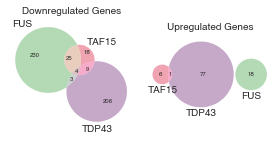

In [28]:
with dataviz.Figure(os.path.join(img_dir, "mn_up_and_down_regulation_overlap.svg"), figsize=(4, 2)) as fig:
    ax = fig.add_subplot(1,2,1)
    venn = venn3([signifcant_downregulated.ix['mn', 'fus'].index,
    signifcant_downregulated.ix['mn', 'taf15'].index,
    signifcant_downregulated.ix['mn', 'tdp43'].index,],
            set_labels=("FUS", "TAF15", "TDP43"), 
        set_colors=(rbp_colors['fus'], rbp_colors['taf15'], rbp_colors['tdp43']), ax=ax)
    ax.set_title("Downregulated Genes", fontsize=10)
    [label.set_fontsize(6) for label in venn.subset_labels]
    [label.set_fontsize(10) for label in venn.set_labels]

    
    ax = fig.add_subplot(1,2,2)
    venn = venn3([signifcant_upregulated.ix['mn', 'fus'].index,
    signifcant_upregulated.ix['mn', 'taf15'].index,
    signifcant_upregulated.ix['mn', 'tdp43'].index,],
            set_labels=("FUS", "TAF15", "TDP43"), 
            set_colors=(rbp_colors['fus'], rbp_colors['taf15'], rbp_colors['tdp43']), ax=ax)
    ax.set_title("Upregulated Genes", fontsize=10)

    [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
    [label.set_fontsize(10) for label in venn.set_labels]

Figure Legend: Venn Diagram of co-up and downregulated changes for TAF15, TDP43 and FUS in MNs

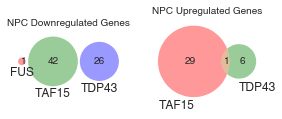

In [29]:
with dataviz.Figure(os.path.join(img_dir, "npc_up_and_down_regulation_overlap.svg"), figsize=(4, 2)) as fig:
    ax = fig.add_subplot(1,2,1)
    venn3([signifcant_downregulated.ix['npc', 'fus'].index,
    signifcant_downregulated.ix['npc', 'taf15'].index,
    signifcant_downregulated.ix['npc', 'tdp43'].index,],
            set_labels=("FUS", "TAF15", "TDP43"), ax = ax )
    ax.set_title("NPC Downregulated Genes", fontsize=10)
    [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
    [label.set_fontsize(10) for label in venn.set_labels]
    
    ax = fig.add_subplot(1,2,2)
    venn2([#signifcant_upregulated.ix['npc', 'fus'].index,
    signifcant_upregulated.ix['npc', 'taf15'].index,
    signifcant_upregulated.ix['npc', 'tdp43'].index,],
            set_labels=("TAF15", "TDP43"), ax = ax )
    ax.set_title("NPC Upregulated Genes", fontsize=10)
    [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
    [label.set_fontsize(10) for label in venn.set_labels]

Figure Legend: Venn Diagram of co-up and downregulated changes for TAF15, TDP43 and FUS in NPCs

#How do the pairwise knockdowns work together for FUS and TAF15?

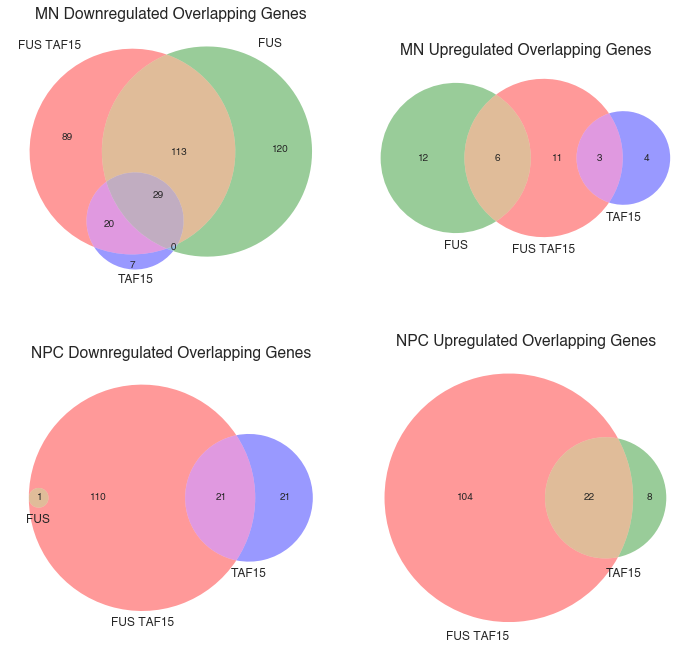

In [30]:
with dataviz.Figure(os.path.join(img_dir, "up_and_down_regulation_overlap_fus_taf15.svg"), figsize=(10, 10)) as fig:
    ax = fig.add_subplot(2,2,1)
    venn3([signifcant_downregulated.ix['mn', 'fus_taf15'].index,
    signifcant_downregulated.ix['mn', 'fus'].index,
    signifcant_downregulated.ix['mn', 'taf15'].index,],
            set_labels=("FUS TAF15", "FUS", "TAF15"), ax=ax)
    ax.set_title("MN Downregulated Overlapping Genes")
    
    ax = fig.add_subplot(2,2,2)
    venn3([signifcant_upregulated.ix['mn', 'fus_taf15'].index,
    signifcant_upregulated.ix['mn', 'fus'].index,
    signifcant_upregulated.ix['mn', 'taf15'].index,],
            set_labels=("FUS TAF15", "FUS", "TAF15"), ax=ax )
    ax.set_title("MN Upregulated Overlapping Genes")
    
    ax = fig.add_subplot(2,2,3)
    venn3([signifcant_downregulated.ix['npc', 'fus_taf15'].index,
    signifcant_downregulated.ix['npc', 'fus'].index,
    signifcant_downregulated.ix['npc', 'taf15'].index,],
            set_labels=("FUS TAF15", "FUS", "TAF15"), ax=ax)
    ax.set_title("NPC Downregulated Overlapping Genes")
    
    ax = fig.add_subplot(2,2,4)
    venn2([signifcant_upregulated.ix['npc', 'fus_taf15'].index,
    #signifcant_upregulated.ix['npc', 'fus'].index,
    signifcant_upregulated.ix['npc', 'taf15'].index,],
            set_labels=("FUS TAF15", "TAF15"), ax=ax )
    ax.set_title("NPC Upregulated Overlapping Genes")

Figure Legend: Venn Diagram of co-up and downregulated changes for the double knockdowns TAF15 and FUS and the single knockdowns of TAF15 and FUS in both MNs and NPCs

#For figure Just the MN FUS / TAF15 Upregulation

In [31]:
img_dir

'/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/'

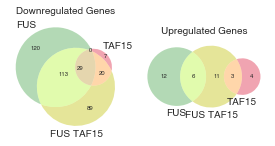

In [32]:
with dataviz.Figure(os.path.join(img_dir, "mn_up_and_down_regulation_overlap_fus_taf15.svg"), figsize=(4, 2)) as fig:
    ax = fig.add_subplot(1,2,1)
    venn = venn3([signifcant_downregulated.ix['mn', 'fus'].index,
                  signifcant_downregulated.ix['mn', 'taf15'].index,
                  signifcant_downregulated.ix['mn', 'fus_taf15'].index,],
            set_labels=("FUS", "TAF15", "FUS TAF15"), 
            set_colors=(rbp_colors['fus'], rbp_colors['taf15'], rbp_colors['fus_taf15']), ax=ax)
    ax.set_title("Downregulated Genes", fontsize=10)
    [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
    [label.set_fontsize(10) for label in venn.set_labels]
    
    ax = fig.add_subplot(1,2,2)
    venn = venn3([signifcant_upregulated.ix['mn', 'fus'].index,
                  signifcant_upregulated.ix['mn', 'taf15'].index,
                  signifcant_upregulated.ix['mn', 'fus_taf15'].index,
                  ],
            set_labels=("FUS", "TAF15", "FUS TAF15"), 
            set_colors=(rbp_colors['fus'], rbp_colors['taf15'], rbp_colors['fus_taf15']), ax=ax)
    ax.set_title("Upregulated Genes", fontsize=10)
    [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
    [label.set_fontsize(10) for label in venn.set_labels]

Figure Legend: Venn Diagram of co-up and downregulated changes for the double knockdowns TAF15 and FUS and the single knockdowns of TAF15 and FUS in MNs 

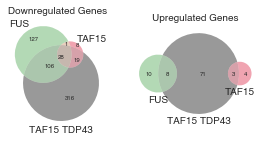

In [33]:
with dataviz.Figure(os.path.join(img_dir, "mn_up_and_down_regulation_overlap_taf15_tbp43.svg"), figsize=(4, 2)) as fig:
    ax = fig.add_subplot(1,2,1)
    venn = venn3([signifcant_downregulated.ix['mn', 'fus'].index,
                  signifcant_downregulated.ix['mn', 'taf15'].index,
                  signifcant_downregulated.ix['mn', 'taf15_tdp43'].index,],
            set_labels=("FUS", "TAF15", "TAF15 TDP43"), 
            set_colors=(rbp_colors['fus'], rbp_colors['taf15'], rbp_colors['taf15_tdp43']), ax=ax)
    ax.set_title("Downregulated Genes", fontsize=10)
    [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
    [label.set_fontsize(10) for label in venn.set_labels]
    
    ax = fig.add_subplot(1,2,2)
    venn = venn3([signifcant_upregulated.ix['mn', 'fus'].index,
                  signifcant_upregulated.ix['mn', 'taf15'].index,
                  signifcant_upregulated.ix['mn', 'taf15_tdp43'].index,
                  ],
            set_labels=("FUS", "TAF15", "TAF15 TDP43"), 
            set_colors=(rbp_colors['fus'], rbp_colors['taf15'], rbp_colors['taf15_tdp43']), ax=ax)
    ax.set_title("Upregulated Genes", fontsize=10)
    [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
    [label.set_fontsize(10) for label in venn.set_labels]

Figure Legend: Venn Diagram of co-up and downregulated changes for the double knockdowns TAF15 and TDP43 and the single knockdowns of TAF15 and TDP43 in MNs 

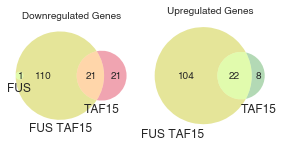

In [34]:
with dataviz.Figure(os.path.join(img_dir, "npc_up_and_down_regulation_overlap_fus_taf15.svg"), figsize=(4, 2)) as fig:
    ax = fig.add_subplot(1,2,1)
    venn3([signifcant_downregulated.ix['npc', 'fus_taf15'].index,
    signifcant_downregulated.ix['npc', 'fus'].index,
    signifcant_downregulated.ix['npc', 'taf15'].index,],
            set_labels=("FUS TAF15", "FUS", "TAF15"), 
            set_colors=( rbp_colors['fus_taf15'], rbp_colors['fus'], rbp_colors['taf15']), ax=ax)

    ax.set_title("Downregulated Genes", fontsize=10)
    [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
    [label.set_fontsize(10) for label in venn.set_labels]
    
    ax = fig.add_subplot(1,2,2)
    venn2([signifcant_upregulated.ix['npc', 'fus_taf15'].index,
    #signifcant_upregulated.ix['npc', 'fus'].index,
    signifcant_upregulated.ix['npc', 'taf15'].index,],
            set_labels=("FUS TAF15", "TAF15"), 
            set_colors=(rbp_colors['fus_taf15'], rbp_colors['fus'], rbp_colors['taf15']), ax=ax)
    ax.set_title("Upregulated Genes", fontsize=10)
    [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
    [label.set_fontsize(10) for label in venn.set_labels]

Figure Legend: Venn Diagram of co-up and downregulated changes for the double knockdowns TAF15 and FUS and the single knockdowns of TAF15 and FUS in NPCs 

In [35]:
# with dataviz.Figure(os.path.join(img_dir, "npc_up_and_down_regulation_overlap_taf15_tbp43.svg"), figsize=(4, 2)) as fig:
#     ax = fig.add_subplot(1,2,1)
#     venn3([signifcant_downregulated.ix['npc', 'taf15_tdp43'].index,
#     signifcant_downregulated.ix['npc', 'fus'].index,
#     signifcant_downregulated.ix['npc', 'taf15'].index,],
#             set_labels=("TAF15 TDP43", "FUS", "TAF15"), 
#             set_colors=( rbp_colors['taf15_tdp43'], rbp_colors['fus'], rbp_colors['taf15']), ax=ax)

#     ax.set_title("Downregulated Genes", fontsize=10)
#     [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
#     [label.set_fontsize(10) for label in venn.set_labels]
    
#     ax = fig.add_subplot(1,2,2)
#     venn2([signifcant_upregulated.ix['npc', 'taf15_tdp43'].index,
#     #signifcant_upregulated.ix['npc', 'fus'].index,
#     signifcant_upregulated.ix['npc', 'taf15'].index,],
#             set_labels=("TAF15 TDP43", "TAF15"), 
#             set_colors=(rbp_colors['taf15_tdp43'], rbp_colors['fus'], rbp_colors['taf15']), ax=ax)
#     ax.set_title("Upregulated Genes", fontsize=10)
#     [label.set_fontsize(6) for label in venn.subset_labels if label is not None]
#     [label.set_fontsize(10) for label in venn.set_labels]

Figure Legend: Venn Diagram of co-up and downregulated changes for the double knockdowns TAF15 and TDP43 and the single knockdowns of TAF15 and TDP43 in NPCs 

#Combine all of the double knockdown venns

In [36]:
# num_rows = 2
# num_cols = 4
# with dataviz.Figure(os.path.join(img_dir, "all_up_and_down_regulation_overlap.svg"), figsize=(num_cols *2.5,  num_rows*2.5)) as fig:
#     gs = gridspec.GridSpec(num_rows, num_cols)
#     counter = 0
#     for x, rbp in enumerate(['fus_taf15', 'taf15_tdp43']):
#         for y, cell_type in enumerate(['mn', 'npc']):
#             for z, (name, df) in enumerate({"Downregulated Genes": signifcant_downregulated, "Upregulated Genes": signifcant_upregulated}.items()):
#                 counter += 1
#                 ax = fig.add_subplot(num_rows, num_cols, counter)
#                 double_name = " ".join(rbp.split("_")).upper()
#                 single_1, single_2 = rbp.split("_")
#                 try:
#                     a = set(df.ix[cell_type, single_1].index)
#                 except KeyError:
#                     a = set()
#                 try:
#                     b = set(df.ix[cell_type, single_2].index)
#                 except KeyError:
#                     b = set()
#                 try:
#                     c= set(df.ix[cell_type, rbp].index)
#                 except KeyError:
#                     c = set()
#                 venn = venn3([a, b, c],
#                         set_labels=(single_1.upper(), single_2.upper(), double_name), 
#                         set_colors=(rbp_colors[single_1], rbp_colors[single_2], rbp_colors[rbp]), ax=ax)
#                 ax.set_title(name, fontsize=16)
#                 [label.set_fontsize(14) for label in venn.subset_labels if label is not None]
#                 [label.set_fontsize(16) for label in venn.set_labels]


Figure Legend: Venn Diagram of co-up and downregulated changes for the double knockdowns TAF15 and FUS or TAF15 and TDP43 and the respective single knockdowns in both MN (first 2 columns) or NPC (second 2 columns)

#Overlaps between cell types

In [37]:
# num_rows = 2
# num_cols = 5
# overlapping = {}
# with dataviz.Figure(os.path.join(img_dir, "up_and_down_regulation_overlap_between_cell_types.svg"), figsize=(num_cols * 2.5, num_rows * 2.5)) as fig:
#     gs = gridspec.GridSpec(num_rows, num_cols)
#     for x, ((downregulated_name, downregluated_df), (upregulated_name, upregluated_df)) in enumerate(zip(signifcant_downregulated.groupby(level="rbp"), signifcant_upregulated.groupby(level="rbp"))):
        
#         ax = fig.add_subplot(gs[1,x]) 
#         venn2([downregluated_df.ix['mn'].index.get_level_values(level='gene'),
#                downregluated_df.ix['npc'].index.get_level_values(level='gene'),
#         ],
#                 set_labels=("MN", "NPC"), ax =ax )
#         ax.set_title("Downregulated\nGenes")

#         ax = fig.add_subplot(gs[0,x]) 
#         venn2([upregluated_df.ix['mn'].index.get_level_values(level='gene'),
#         upregluated_df.ix['npc'].index.get_level_values(level='gene'),
#         ],
#                 set_labels=("MN", "NPC"), ax =ax )
#         ax.set_title(rbp_names[upregulated_name] + "\nUpregulated Genes")
        
#         overlapping["downregulated_" + downregulated_name] = Counter(downregluated_df.ix['mn'].index.get_level_values(level='gene') & downregluated_df.ix['npc'].index.get_level_values(level='gene'))
#         overlapping["upregulated_" + upregulated_name] = Counter(upregluated_df.ix['mn'].index.get_level_values(level='gene') & upregluated_df.ix['npc'].index.get_level_values(level='gene'),)


Figure Legend: Venn Diagram of co-up and downregulated changes the same knockdown in NPC and MNs

#ALS Specific Gene Analysis

In [38]:
name_to_gene_id_lower = {key.lower(): value for key, value in name_to_gene_id.items()}
als_specific_genes = pd.read_excel("/nas3/gpratt/Dropbox/TAF15/Data/als_specific_genes/Workbook1.xlsx", "Sheet1")

In [39]:
als_specifc_gene_list = []
for als_gene in als_specific_genes['Gene symbol']:
    try:
        als_specifc_gene_list.append(name_to_gene_id[als_gene])
    except KeyError:
        print als_gene

ALS3
ALS7
SYNE


In [40]:
HTML(significant_knockdowns[[gene_id in als_specifc_gene_list for gene_id in significant_knockdowns.index.get_level_values(level="gene")]].to_html())

In [41]:
combined_significant_knockdowns = pd.concat([significant_knockdowns, ips_significant_knockdowns])

In [44]:
filtered_kds = combined_significant_knockdowns.ix[['R521G', 'mn']]
unfiltered_kds = pd.concat([knockdowns, ips_knockdowns]).ix[['R521G', 'mn']].log2FoldChange.unstack()

filtered_kds = filtered_kds[[gene_id in als_specifc_gene_list for gene_id in filtered_kds.index.get_level_values(level="gene")]].log2FoldChange.unstack()
unfiltered_kds = unfiltered_kds[filtered_kds.columns]
unfiltered_kds.columns = [gene_id_to_name[name] for name in unfiltered_kds.columns]

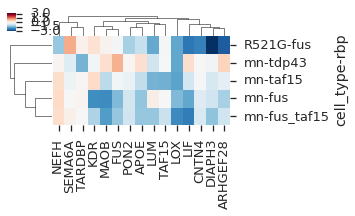

In [240]:
sns.clustermap(unfiltered_kds.drop("taf15_tdp43", level=1).fillna(0), figsize=(4,2))
plt.savefig(os.path.join(img_dir, "als_specific_genes_l2fc.pdf"))
plt.savefig(os.path.join(img_dir, "als_specific_genes_l2fc.svg"))

In [46]:
ips_significant_knockdowns[[gene_id in als_specifc_gene_list for gene_id in ips_significant_knockdowns.index.get_level_values(level="gene")]]

baseMean  log2FoldChange     lfcSE  \
rbp   mutation gene                                                        
G298S tdp      ENSG00000144619.10   401.709530        2.262603  0.391672   
               ENSG00000214944.5     55.676331       -1.608601  0.397898   
N352S tdp      ENSG00000127824.9     41.721284       -2.550220  0.433460   
               ENSG00000128342.4     20.073676       -2.293051  0.549375   
               ENSG00000130203.5     59.169472       -1.314185  0.247276   
               ENSG00000144619.10   745.866733        2.386109  0.571528   
               ENSG00000178568.9    164.473126        2.044572  0.571412   
               ENSG00000183036.6    425.573594        1.378802  0.404397   
               ENSG00000214944.5     36.365051       -1.405718  0.351919   
R521G fus      ENSG00000092421.12  2997.224423        1.128956  0.240848   
               ENSG00000100285.9   1681.878856       -1.159378  0.392069   
               ENSG00000105854.8    264.534514       -1.009188  0.172076   
               ENSG00000128342.4     35.242698       -2.223747  0.588658   
               ENSG00000139734.13    17.190049       -3.064969  0.640195   
               ENSG00000144619.10    59.377622       -2.067597  0.750627   
               ENSG00000214944.5     45.077891       -2.539500  0.389458   
T198C fus      ENSG00000092421.12  2720.059517        1.131274  0.177026   
               ENSG00000100285.9   1692.310181       -1.502627  0.481622   
               ENSG00000127824.9     82.019009       -2.219498  0.608293   
               ENSG00000130203.5     89.812265       -1.199308  0.367573   
               ENSG00000134115.8     96.368123       -4.921526  0.576228   
               ENSG00000134532.11   505.999127        1.272698  0.358248   
               ENSG00000149654.5     91.694048       -1.444670  0.464429   
               ENSG00000150938.5   2671.869028        1.210986  0.332587   
               ENSG00000214944.5     49.340917       -2.625257  0.497247   
               ENSG00000262359.1    224.636447       -2.061917  0.353302   

                                       stat        pvalue          padj  \
rbp   mutation gene                                                       
G298S tdp      ENSG00000144619.10  5.776775  7.614603e-09  1.279380e-05   
               ENSG00000214944.5  -4.042743  5.282951e-05  7.406731e-03   
N352S tdp      ENSG00000127824.9  -5.883398  4.019287e-09  1.195173e-06   
               ENSG00000128342.4  -4.173928  2.993927e-05  1.233278e-03   
               ENSG00000130203.5  -5.314640  1.068683e-07  1.667372e-05   
               ENSG00000144619.10  4.174964  2.980329e-05  1.233278e-03   
               ENSG00000178568.9   3.578105  3.460940e-04  6.632946e-03   
               ENSG00000183036.6   3.409527  6.507566e-04  1.015960e-02   
               ENSG00000214944.5  -3.994434  6.484907e-05  2.153827e-03   
R521G fus      ENSG00000092421.12  4.687431  2.766556e-06  9.781824e-05   
               ENSG00000100285.9  -2.957078  3.105696e-03  2.584298e-02   
               ENSG00000105854.8  -5.864800  4.496751e-09  4.448604e-07   
               ENSG00000128342.4  -3.777654  1.583127e-04  2.687201e-03   
               ENSG00000139734.13 -4.787555  1.688259e-06  6.535497e-05   
               ENSG00000144619.10 -2.754495  5.878279e-03  4.104946e-02   
               ENSG00000214944.5  -6.520607  7.002354e-11  1.106146e-08   
T198C fus      ENSG00000092421.12  6.390451  1.653973e-10  3.243276e-08   
               ENSG00000100285.9  -3.119932  1.808930e-03  4.105477e-02   
               ENSG00000127824.9  -3.648734  2.635357e-04  9.516890e-03   
               ENSG00000130203.5  -3.262775  1.103270e-03  2.857863e-02   
               ENSG00000134115.8  -8.540932  1.331430e-17  5.675654e-15   
               ENSG00000134532.11  3.552565  3.814953e-04  1.276577e-02   
               ENSG00000149654.5  -3.110640  1.866827e-03  4.198005e-02   
               ENSG00000150938.5  

It looks like LIF is one of the few genes that is consistantly downregulated in MNs for both FUS and TDP mutants and konckdowns.  Lets double check by looking at the rpkms

#Lif Only Analysis

In [192]:
def gene_specific_formatting(series):
    df = pd.DataFrame(series)
    df['cell_type'] = df.index.get_level_values(level='cell_type')
    df['exp'] = df.index.get_level_values(level='exp')
    df['knockdown'] = df.index.get_level_values(level='knockdown')
    df['rep'] = df.index.get_level_values(level='rep')
    #hacky way to reorder this ish

    reorder = {'Scrm' : 0 , 
     'TAF15_TDP43': 1, 
     'TDP43': 2, 
     'TAF15': 3,
     'FUS_TAF15': 4,
     'FUS': 5}

    new_index = []
    for index in df.index:
        index = list(index)
        index.append(reorder[index[2]])
        new_index.append(index)
    df.index = pd.MultiIndex.from_tuples(new_index, names=['cell_type', 'exp', 'knockdown', 'rep', "sort_order"])
    df = df.sortlevel("sort_order")
    return df

In [196]:
gene_specific_formatting(stat3_only)

ENSG00000168610.10  \
cell_type exp                 knockdown   rep sort_order                       
MN        Scrm_1              Scrm        1   0                    44.334587   
          Scrm_2              Scrm        2   0                    45.262888   
NPC       NPC_Scrm_1_p7_35    Scrm        1   0                    17.838766   
          NPC_Scrm_2_p7_44    Scrm        2   0                    12.354919   
MN        TAF15_TDP43_shRNA_1 TAF15_TDP43 1   1                    43.007549   
          TAF15_TDP43_shRNA_2 TAF15_TDP43 2   1                    42.736920   
NPC       NPC_T+T_1_p7_44     TAF15_TDP43 1   1                    21.507611   
          NPC_T+T_2_p7_44     TAF15_TDP43 2   1                    19.308973   
MN        TDP43_shRNA_1       TDP43       1   2                    43.097719   
          TDP43_shRNA_2       TDP43       2   2                    39.474013   
NPC       NPC_TDP43_1_p_44    TDP43       1   2                    25.317465   
MN        TAF15_shRNA_1       TAF15       1   3                    40.320459   
          TAF15_shRNA_2       TAF15       2   3                    38.683375   
NPC       NPC_TAF15_1_p7_35   TAF15       1   3                    19.409152   
          NPC_TAF15_2_p7_44   TAF15       2   3                    24.611085   
MN        FUS_TAF15_shRNA_1   FUS_TAF15   1   4                    39.807770   
          FUS_TAF15_shRNA_2   FUS_TAF15   2   4                    37.580115   
NPC       NPC_T+F_1_p7_44     FUS_TAF15   1   4                    20.987292   
          NPC_T+F_2_p7_44     FUS_TAF15   2   4                    20.520847   
MN        FUS_shRNA_1         FUS         1   5                    37.184651   
          FUS_shRNA_2         FUS         2   5                    37.412899   
NPC       NPC_FUS_1_p7_35     FUS         1   5                     7.103218   
          NPC_FUS_2_p7_44     FUS         2   5                    16.054412   

                                                         cell_type  \
cell_type exp                 knockdown   rep sort_order             
MN        Scrm_1              Scrm        1   0                 MN   
          Scrm_2              Scrm        2   0                 MN   
NPC       NPC_Scrm_1_p7_35    Scrm        1   0                NPC   
          NPC_Scrm_2_p7_44    Scrm        2   0                NPC   
MN        TAF15_TDP43_shRNA_1 TAF15_TDP43 1   1                 MN   
          TAF15_TDP43_shRNA_2 TAF15_TDP43 2   1                 MN   
NPC       NPC_T+T_1_p7_44     TAF15_TDP43 1   1                NPC   
          NPC_T+T_2_p7_44     TAF15_TDP43 2   1                NPC   
MN        TDP43_shRNA_1       TDP43       1   2                 MN   
          TDP43_shRNA_2       TDP43       2   2                 MN   
NPC       NPC_TDP43_1_p_44    TDP43       1   2                NPC   
MN        TAF15_shRNA_1       TAF15       1   3                 MN   
          TAF15_shRNA_2       TAF15       2   3                 MN   
NPC       NPC_TAF15_1_p7_35   TAF15       1   3                NPC   
          NPC_TAF15_2_p7_44   TAF15       2   3                NPC   
MN        FUS_TAF15_shRNA_1   FUS_TAF15   1   4                 MN   
          FUS_TAF15_shRNA_2   FUS_TAF15   2   4                 MN   
NPC       NPC_T+F_1_p7_44     FUS_TAF15   1   4                NPC   
          NPC_T+F_2_p7_44     FUS_TAF15   2   4                NPC   
MN        FUS_shRNA_1         FUS         1   5                 MN   
          FUS_shRNA_2         FUS         2   5                 MN   
NPC       NPC_FUS_1_p7_35     FUS         1   5                NPC   
          NPC_FUS_2_p7_44     FUS         2   5                NPC   

                                                                          exp  \
cell_type exp                 knockdown   rep sort_order                        
MN        Scrm_1              Scrm        1   0                        Scrm_1   
          Scrm_2              Scrm        2   0                

In [109]:
lif_only = rpkm[name_to_gene_id['LIF']].copy()
lif_only_df = gene_specific_formatting(lif_only)

#DESeq Issue Checking

In [245]:
unfiltered_kds['LIF']

cell_type  rbp        
R521G      fus           -2.223747
mn         fus           -1.587974
           fus_taf15     -2.141126
           taf15         -0.557197
           taf15_tdp43   -1.071474
           tdp43          0.528306
Name: LIF, dtype: float64

In [252]:
foo = lif_only_df.ix['MN'].groupby("knockdown").mean()

In [ ]:
counts

In [262]:
knockdowns[knockdowns.gene_name == "LIF"]

baseMean  log2FoldChange     lfcSE  \
cell_type rbp         gene                                                      
mn        fus         ENSG00000128342.4  169.665298       -1.587974  0.211612   
          fus_taf15   ENSG00000128342.4  126.586256       -2.141126  0.264620   
          taf15       ENSG00000128342.4  206.202368       -0.557197  0.196889   
          taf15_tdp43 ENSG00000128342.4  175.234101       -1.071474  0.211901   
          tdp43       ENSG00000128342.4  124.051725        0.528306  0.357228   
npc       fus         ENSG00000128342.4  248.941239        0.379897  0.425227   
          fus_taf15   ENSG00000128342.4  300.760072        0.476958  0.299251   
          taf15       ENSG00000128342.4  383.080323        0.754947  0.317552   
          taf15_tdp43 ENSG00000128342.4  596.912191        1.138125  0.278037   
          tdp43       ENSG00000128342.4  326.539709        1.129166  0.457085   

                                             stat        pvalue          padj  \
cell_type rbp         gene                                                      
mn        fus         ENSG00000128342.4 -7.504163  6.182222e-14  4.576839e-12   
          fus_taf15   ENSG00000128342.4 -8.091334  5.901466e-16  5.002297e-14   
          taf15       ENSG00000128342.4 -2.830006  4.654710e-03  5.425375e-02   
          taf15_tdp43 ENSG00000128342.4 -5.056490  4.270430e-07  7.156917e-06   
          tdp43       ENSG00000128342.4  1.478904  1.391659e-01  3.581402e-01   
npc       fus         ENSG00000128342.4  0.893398  3.716442e-01           NaN   
          fus_taf15   ENSG00000128342.4  1.593841  1.109717e-01  4.386298e-01   
          taf15       ENSG00000128342.4  2.377395  1.743542e-02  4.399461e-01   
          taf15_tdp43 ENSG00000128342.4  4.093426  4.250451e-05  9.665109e-04   
          tdp43       ENSG00000128342.4  2.470363  1.349761e-02           NaN   

                                        gene_name  
cell_type rbp         gene                         
mn        fus         ENSG00000128342.4       LIF  
          fus_taf15   ENSG00000128342.4       LIF  
          taf15       ENSG00000128342.4       LIF  
          taf15_tdp43 ENSG00000128342.4       LIF  
          tdp43       ENSG00000128342.4       LIF  
npc       fus         ENSG00000128342.4       LIF  
          fus_taf15   ENSG00000128342.4       LIF  
          taf15       ENSG00000128342.4       LIF  
          taf15_tdp43 ENSG00000128342.4       LIF  
          tdp43       ENSG00000128342.4       LIF

In [257]:
lif_only_df.ix['MN']

,,,,ENSG00000128342.4,cell_type,exp,knockdown,rep
exp,knockdown,rep,sort_order,,,,,
Scrm_1,Scrm,1,0,2.774971,MN,Scrm_1,Scrm,1
Scrm_2,Scrm,2,0,3.159438,MN,Scrm_2,Scrm,2
TAF15_TDP43_shRNA_1,TAF15_TDP43,1,1,1.811600,MN,TAF15_TDP43_shRNA_1,TAF15_TDP43,1
TAF15_TDP43_shRNA_2,TAF15_TDP43,2,1,2.274820,MN,TAF15_TDP43_shRNA_2,TAF15_TDP43,2
TDP43_shRNA_1,TDP43,1,2,1.529337,MN,TDP43_shRNA_1,TDP43,1
TDP43_shRNA_2,TDP43,2,2,1.557172,MN,TDP43_shRNA_2,TDP43,2
TAF15_shRNA_1,TAF15,1,3,1.541672,MN,TAF15_shRNA_1,TAF15,1
TAF15_shRNA_2,TAF15,2,3,1.407577,MN,TAF15_shRNA_2,TAF15,2
FUS_TAF15_shRNA_1,FUS_TAF15,1,4,0.943316,MN,FUS_TAF15_shRNA_1,FUS_TAF15,1


In [264]:
mn_counts.ix['ENSG00000128342.4']

Chr                             chr22;chr22;chr22
Start                  30636436;30640744;30642666
End                    30640050;30640922;30642840
Strand                                      -;-;-
Length                                       3969
FUS_shRNA_1                                   104
FUS_shRNA_2                                   112
FUS_TAF15_shRNA_1                              31
FUS_TAF15_shRNA_2                              69
Scrm_1                                        157
Scrm_2                                        249
TAF15_shRNA_1                                 202
TAF15_shRNA_2                                 211
TAF15_TDP43_shRNA_1                           150
TAF15_TDP43_shRNA_2                           123
TDP43_shRNA_1                                 157
TDP43_shRNA_2                                 110
Name: ENSG00000128342.4, dtype: object

In [255]:
np.log2(foo / foo.ix['Scrm'])

,ENSG00000128342.4,rep
knockdown,,
FUS,-2.200181,0
FUS_TAF15,-1.613689,0
Scrm,0.000000,0
TAF15,-1.008757,0
TAF15_TDP43,-0.538267,0
TDP43,-0.943128,0


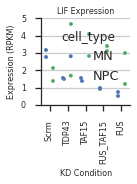

In [243]:
num_rows = 2
num_cols = 1
with sns.axes_style("ticks", {'axes.grid': True}):
    with dataviz.Figure(os.path.join(img_dir, "lif_kd_expression.svg"), figsize=(2.0 * num_cols, 2.0 * num_rows)) as fig:
        ax = fig.add_subplot(num_rows,num_cols,1)

        sns.stripplot("knockdown", "ENSG00000128342.4", 
                       "cell_type", 
                       data=lif_only_df.drop("TAF15_TDP43", level="knockdown"), 
                      size=4,
                      linewidth=.1,
                      jitter=.05,
                       ax=ax)


        ax.set_ylabel("Expression (RPKM)", fontsize=8)
        ax.set_title("LIF Expression", fontsize=8)
        ax.set_xlabel("KD Condition", fontsize=8)
        sns.despine(ax=ax)
        [tick.set_rotation(90) for tick in ax.get_xticklabels()]
        [tick.set_fontsize(8) for tick in ax.get_xticklabels()]
        [tick.set_fontsize(8) for tick in ax.get_yticklabels()]

In [197]:
stat3_only = rpkm[name_to_gene_id['STAT3']].copy()
stat3_only = gene_specific_formatting(stat3_only)

In [198]:
stat3_only

ENSG00000168610.10  \
cell_type exp                 knockdown   rep sort_order                       
MN        Scrm_1              Scrm        1   0                    44.334587   
          Scrm_2              Scrm        2   0                    45.262888   
NPC       NPC_Scrm_1_p7_35    Scrm        1   0                    17.838766   
          NPC_Scrm_2_p7_44    Scrm        2   0                    12.354919   
MN        TAF15_TDP43_shRNA_1 TAF15_TDP43 1   1                    43.007549   
          TAF15_TDP43_shRNA_2 TAF15_TDP43 2   1                    42.736920   
NPC       NPC_T+T_1_p7_44     TAF15_TDP43 1   1                    21.507611   
          NPC_T+T_2_p7_44     TAF15_TDP43 2   1                    19.308973   
MN        TDP43_shRNA_1       TDP43       1   2                    43.097719   
          TDP43_shRNA_2       TDP43       2   2                    39.474013   
NPC       NPC_TDP43_1_p_44    TDP43       1   2                    25.317465   
MN        TAF15_shRNA_1       TAF15       1   3                    40.320459   
          TAF15_shRNA_2       TAF15       2   3                    38.683375   
NPC       NPC_TAF15_1_p7_35   TAF15       1   3                    19.409152   
          NPC_TAF15_2_p7_44   TAF15       2   3                    24.611085   
MN        FUS_TAF15_shRNA_1   FUS_TAF15   1   4                    39.807770   
          FUS_TAF15_shRNA_2   FUS_TAF15   2   4                    37.580115   
NPC       NPC_T+F_1_p7_44     FUS_TAF15   1   4                    20.987292   
          NPC_T+F_2_p7_44     FUS_TAF15   2   4                    20.520847   
MN        FUS_shRNA_1         FUS         1   5                    37.184651   
          FUS_shRNA_2         FUS         2   5                    37.412899   
NPC       NPC_FUS_1_p7_35     FUS         1   5                     7.103218   
          NPC_FUS_2_p7_44     FUS         2   5                    16.054412   

                                                         cell_type  \
cell_type exp                 knockdown   rep sort_order             
MN        Scrm_1              Scrm        1   0                 MN   
          Scrm_2              Scrm        2   0                 MN   
NPC       NPC_Scrm_1_p7_35    Scrm        1   0                NPC   
          NPC_Scrm_2_p7_44    Scrm        2   0                NPC   
MN        TAF15_TDP43_shRNA_1 TAF15_TDP43 1   1                 MN   
          TAF15_TDP43_shRNA_2 TAF15_TDP43 2   1                 MN   
NPC       NPC_T+T_1_p7_44     TAF15_TDP43 1   1                NPC   
          NPC_T+T_2_p7_44     TAF15_TDP43 2   1                NPC   
MN        TDP43_shRNA_1       TDP43       1   2                 MN   
          TDP43_shRNA_2       TDP43       2   2                 MN   
NPC       NPC_TDP43_1_p_44    TDP43       1   2                NPC   
MN        TAF15_shRNA_1       TAF15       1   3                 MN   
          TAF15_shRNA_2       TAF15       2   3                 MN   
NPC       NPC_TAF15_1_p7_35   TAF15       1   3                NPC   
          NPC_TAF15_2_p7_44   TAF15       2   3                NPC   
MN        FUS_TAF15_shRNA_1   FUS_TAF15   1   4                 MN   
          FUS_TAF15_shRNA_2   FUS_TAF15   2   4                 MN   
NPC       NPC_T+F_1_p7_44     FUS_TAF15   1   4                NPC   
          NPC_T+F_2_p7_44     FUS_TAF15   2   4                NPC   
MN        FUS_shRNA_1         FUS         1   5                 MN   
          FUS_shRNA_2         FUS         2   5                 MN   
NPC       NPC_FUS_1_p7_35     FUS         1   5                NPC   
          NPC_FUS_2_p7_44     FUS         2   5                NPC   

                                                                          exp  \
cell_type exp                 knockdown   rep sort_order                        
MN        Scrm_1              Scrm        1   0                        Scrm_1   
          Scrm_2              Scrm        2   0                

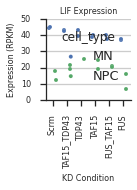

In [199]:
num_rows = 2
num_cols = 1
with sns.axes_style("ticks", {'axes.grid': True}):
    with dataviz.Figure(os.path.join(img_dir, "stat3_kd_expression.svg"), figsize=(2.0 * num_cols, 2.0 * num_rows)) as fig:
        ax = fig.add_subplot(num_rows,num_cols,1)

        sns.stripplot("knockdown", "ENSG00000168610.10", 
                       "cell_type", 
                       data=stat3_only, 
                      size=4,
                      linewidth=.1,
                      jitter=.05,
                       ax=ax)


        ax.set_ylabel("Expression (RPKM)", fontsize=8)
        ax.set_title("LIF Expression", fontsize=8)
        ax.set_xlabel("KD Condition", fontsize=8)
        sns.despine(ax=ax)
        [tick.set_rotation(90) for tick in ax.get_xticklabels()]
        [tick.set_fontsize(8) for tick in ax.get_xticklabels()]
        [tick.set_fontsize(8) for tick in ax.get_yticklabels()]

In [176]:
knockdowns[knockdowns.gene_name == "STAT3"]

baseMean  log2FoldChange  \
cell_type rbp         gene                                              
mn        fus         ENSG00000168610.10  7964.115646       -0.234703   
          fus_taf15   ENSG00000168610.10  6334.296867       -0.312846   
          taf15       ENSG00000168610.10  7999.419652       -0.093168   
          taf15_tdp43 ENSG00000168610.10  7328.049979       -0.268035   
          tdp43       ENSG00000168610.10  9614.191766        0.063117   
npc       fus         ENSG00000168610.10  3778.601493       -0.200934   
          fus_taf15   ENSG00000168610.10  5273.274857        0.280509   
          taf15       ENSG00000168610.10  6074.044167        0.345343   
          taf15_tdp43 ENSG00000168610.10  8716.313366        0.569455   
          tdp43       ENSG00000168610.10  4626.937128        0.350515   

                                             lfcSE      stat        pvalue  \
cell_type rbp         gene                                                   
mn        fus         ENSG00000168610.10  0.060602 -3.872876  1.075585e-04   
          fus_taf15   ENSG00000168610.10  0.058058 -5.388540  7.103230e-08   
          taf15       ENSG00000168610.10  0.054308 -1.715540  8.624627e-02   
          taf15_tdp43 ENSG00000168610.10  0.052024 -5.152098  2.575885e-07   
          tdp43       ENSG00000168610.10  0.080379  0.785245  4.323099e-01   
npc       fus         ENSG00000168610.10  0.370633 -0.542138  5.877233e-01   
          fus_taf15   ENSG00000168610.10  0.224891  1.247311  2.122834e-01   
          taf15       ENSG00000168610.10  0.263177  1.312205  1.894510e-01   
          taf15_tdp43 ENSG00000168610.10  0.229167  2.484886  1.295929e-02   
          tdp43       ENSG00000168610.10  0.380074  0.922229  3.564090e-01   

                                              padj gene_name  
cell_type rbp         gene                                    
mn        fus         ENSG00000168610.10  0.001560     STAT3  
          fus_taf15   ENSG00000168610.10  0.000002     STAT3  
          taf15       ENSG00000168610.10  0.374005     STAT3  
          taf15_tdp43 ENSG00000168610.10  0.000005     STAT3  
          tdp43       ENSG00000168610.10  0.695905     STAT3  
npc       fus         ENSG00000168610.10  0.999992     STAT3  
          fus_taf15   ENSG00000168610.10  0.569794     STAT3  
          taf15       ENSG00000168610.10  0.775510     STAT3  
          taf15_tdp43 ENSG00000168610.10  0.073624     STAT3  
          tdp43       ENSG00000168610.10  0.960652     STAT3

#Lets try GO Analysis

In [51]:
hg19go = GO.hg19GO()

#Down Regulated Genes

In [52]:
signifcant_downregulated.xs(name_to_gene_id['ITGA5'], level="gene")

baseMean  log2FoldChange     lfcSE       stat  \
cell_type rbp                                                            
mn        fus          272.159783       -1.229840  0.173994  -7.068301   
          fus_taf15    201.508570       -1.743419  0.208679  -8.354566   
          taf15        255.279670       -1.336609  0.179645  -7.440260   
          taf15_tdp43  204.424704       -2.702241  0.221240 -12.214065   

                             pvalue          padj gene_name  
cell_type rbp                                                
mn        fus          1.568421e-12  1.015464e-10     ITGA5  
          fus_taf15    6.567376e-17  6.003354e-15     ITGA5  
          taf15        1.004874e-13  1.752424e-11     ITGA5  
          taf15_tdp43  2.614893e-34  4.386745e-32     ITGA5

In [53]:
for name, df in signifcant_downregulated.groupby(level="rbp"):
    df.to_csv("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/downregulated_" + name + ".csv")
    
for name, df in signifcant_upregulated.groupby(level="rbp"):
    df.to_csv("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/upregulated_" + name + ".csv")

In [54]:
#This takes a few minutes...
downregulated_go = {}
for name, df in signifcant_downregulated.groupby(level=["cell_type", "rbp"]):
    cell_type = name[0]
    downregulated_go[name] = hg19go.enrichment(gencode_to_ensembl(df.index.get_level_values(level="gene")),
                                               background=expressed_genes[cell_type])
    
downregulated_go = pd.concat(downregulated_go, names=['cell_type', 'rbp', 'go_term_id'])
downregulated_go = downregulated_go[downregulated_go['Bonferroni-corrected Hypergeometric p-Value'] < .05]

upregulated_go = {}
for name, df in signifcant_upregulated.groupby(level=["cell_type", "rbp"]):
    cell_type = name[0]
    upregulated_go[name] = hg19go.enrichment(gencode_to_ensembl(df.index.get_level_values(level="gene")),
                                             background=expressed_genes[cell_type])
    
upregulated_go = pd.concat(upregulated_go,  names=['cell_type', 'rbp', 'go_term_id'])
upregulated_go = upregulated_go[upregulated_go['Bonferroni-corrected Hypergeometric p-Value'] < .05]


In [55]:
#All Terms Up and Down Regulated

In [211]:
HTML(downregulated_go[downregulated_go['Bonferroni-corrected Hypergeometric p-Value'] < .05].ix['mn', 'fus_taf15'].to_html())

,GO Term Description,Bonferroni-corrected Hypergeometric p-Value,N Genes in List and GO Category,N Expressed Genes in GO Category,N Genes in GO category,Ensembl Gene IDs in List,Gene symbols in List,GO domain,Hypergeometric p-Value
go_term_id,,,,,,,,,
GO:0005576,extracellular region,3.709068e-32,59,511,1758,"ENSG00000060718,ENSG00000115414,ENSG0000017697...","CCL2,TGFB2,LUM,COL11A1,LIF,MAPK15,FST,NOTCH2,F...",cellular_component,1.619680e-34
GO:0005615,extracellular space,6.185985e-32,46,277,904,"ENSG00000113083,ENSG00000164932,ENSG0000019759...","CCL2,TGFB2,LUM,TNC,LIF,FSTL3,FBN1,LOX,THBS1,EG...",cellular_component,2.701303e-34
GO:0031012,extracellular matrix,4.647447e-19,24,114,229,"ENSG00000060718,ENSG00000140873,ENSG0000016493...","TGFB2,TIMP3,COL11A1,ADAMTS15,ADAMTS18,THBS1,SE...",cellular_component,2.029453e-21
GO:0005581,collagen,5.463803e-16,13,28,92,"ENSG00000188153,ENSG00000060718,ENSG0000011308...","COL11A1,PLOD2,C1QTNF3,COL22A1,COL5A2,COL4A5,CO...",cellular_component,2.385940e-18
GO:0005886,plasma membrane,1.860435e-12,70,1644,3897,"ENSG00000151572,ENSG00000139278,ENSG0000019759...","TAP1,PDGFRB,FGFRL1,DIRAS3,ANO4,EVA1A,ITGA5,ANO...",cellular_component,8.124169e-15
GO:0005578,proteinaceous extracellular matrix,5.940343e-12,16,84,231,"ENSG00000120708,ENSG00000115414,ENSG0000011308...","LTBP2,FN1,LTBP1,WNT5A,FBN2,SPARC,TFPI2,FBN1,CT...",cellular_component,2.594036e-14
GO:0030199,collagen fibril organization,1.582175e-11,10,25,46,"ENSG00000060718,ENSG00000166923,ENSG0000011308...","TGFBR1,GREM1,COL11A1,TGFB2,LUM,COL5A2,SERPINH1...",biological_process,6.909063e-14
GO:0005515,protein binding,2.610107e-11,154,5928,9884,"ENSG00000196411,ENSG00000115738,ENSG0000011308...","TAP1,HSPA2,FGFRL1,TIMP3,FKBP10,WLS,LDLRAD4,S10...",molecular_function,1.139785e-13
GO:0006955,immune response,7.800564e-11,15,83,561,"ENSG00000134954,ENSG00000108691,ENSG0000000851...","CCL2,BMP6,LIF,CXCL5,FAS,TRIM22,ENPP1,SMAD3,ETS...",biological_process,3.406360e-13


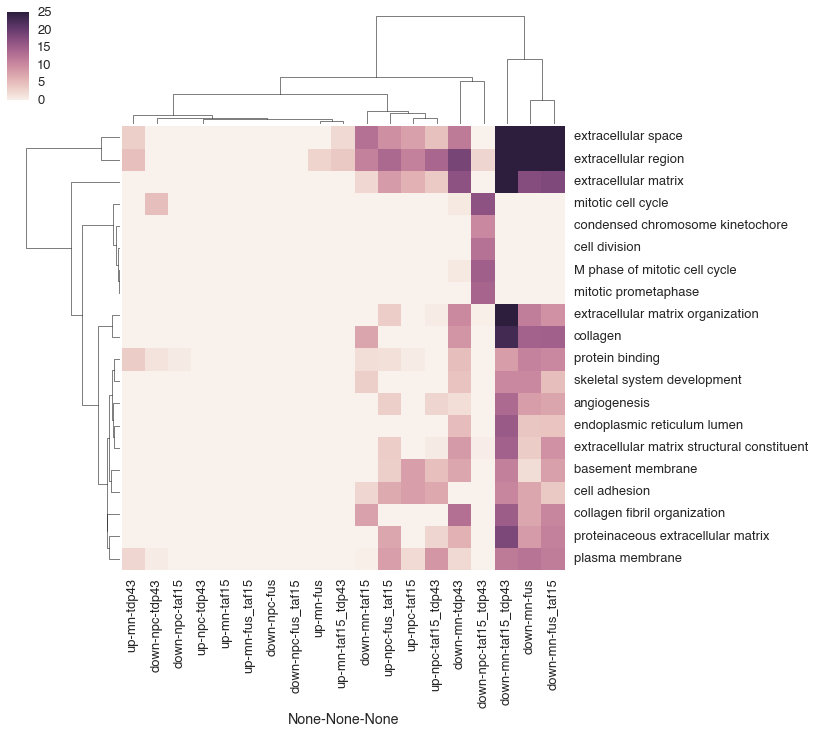

In [56]:
dataviz.plot_go_enrichment(pd.concat({"up":upregulated_go, "down": downregulated_go}), max_terms=20, filter_value=3, figsize=(10,10))
plt.savefig(os.path.join(img_dir, "all_go.pdf"))
plt.savefig(os.path.join(img_dir, "all_go.svg"))

Figure Legend: Top 20 Enriched GO terms for all knockdowns in NPC and MNs

#Down Regulated GO Terms

In [57]:
#HTML(downregulated_go.to_html())

#Downregulated Everything

In [58]:
#dataviz.plot_go_enrichment(downregulated_go, filter_value=5, figsize=(10,40))

Figure Legend: All Enriched GO terms for Downregulated Genes in all knockdowns

#Downregulated MN

In [59]:
#dataviz.plot_go_enrichment(downregulated_go.ix['mn'], filter_value=5, figsize=(10,40))


Figure Legend: All Enriched GO terms for Downregulated Genes in MN knockdowns

#DownRegulated NPC

In [60]:
#dataviz.plot_go_enrichment(downregulated_go.ix['npc'], filter_value=5)

Figure Legend: All Enriched GO terms for Downregulated Genes in NPC knockdowns

#Up Regulated GO Terms

In [61]:
#HTML(upregulated_go.to_html())

#Upregulated Everything

In [62]:
#dataviz.plot_go_enrichment(upregulated_go, filter_value=2, figsize=(10,40))

Figure Legend: All Enriched GO terms for upregulated Genes in all knockdowns

#Upregulated MN

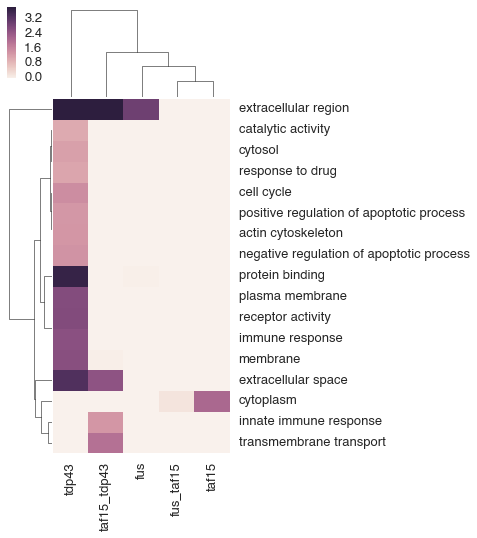

In [63]:
dataviz.plot_go_enrichment(upregulated_go.ix['mn'], filter_value=1, figsize=(4,8))
plt.savefig(os.path.join(img_dir, "mn_upregulated_go.pdf"))
plt.savefig(os.path.join(img_dir, "mn_upregulated_go.svg"))

Figure Legend: All Enriched GO terms for upregulated Genes in MN knockdowns

#Upregulated NPC

In [64]:
#dataviz.plot_go_enrichment(upregulated_go.ix['npc'], filter_value=2, figsize=(5,30))

Figure Legend: All Enriched GO terms for upregulated Genes in NPC knockdowns

#GO Comparison between Overlapping MN and NPC Changing Genes 

In [65]:
overlapping_downregulated_go = {}
overlapping_upregulated_go = {}
for (downregulated_name, downregluated_df), (upregulated_name, upregluated_df) in zip(signifcant_downregulated.groupby(level="rbp"), signifcant_upregulated.groupby(level="rbp")):
    overlapping_downregulated_genes = (downregluated_df.ix['mn'].index.get_level_values(level='gene') & downregluated_df.ix['npc'].index.get_level_values(level='gene'))
    overlapping_upregulated_genes = (upregluated_df.ix['mn'].index.get_level_values(level='gene') & upregluated_df.ix['npc'].index.get_level_values(level='gene'))

    overlapping_downregulated_go[downregulated_name] = hg19go.enrichment(gencode_to_ensembl(overlapping_downregulated_genes),
                                                                         background=(set(expressed_genes['mn']) | set(expressed_genes['npc'])))
    overlapping_upregulated_go[upregulated_name] = hg19go.enrichment(gencode_to_ensembl(overlapping_upregulated_genes),
                                                                     background=(set(expressed_genes['mn']) | set(expressed_genes['npc'])))
    
overlapping_downregulated_go = pd.concat(overlapping_downregulated_go)
overlapping_upregulated_go = pd.concat(overlapping_upregulated_go)

overlapping_all_go = pd.concat({"downregulated": overlapping_downregulated_go,
                      "upregulated": overlapping_upregulated_go})

overlapping_all_go = overlapping_all_go.dropna()

#Overlapping All GO Terms

In [66]:
#dataviz.plot_go_enrichment(overlapping_all_go, figsize=(5,15))

Figure Legend: GO Enrichment of genes that are changing in both MN and NPC in the same direction. (this is all significant events for all pairs of knockdowns, there aren’t many overlaps and so not many common changes)

#Overlapping upregulated GO Terms

In [67]:
HTML(overlapping_upregulated_go.to_html())

#Double Knockdown Unique Changes Analysis

In [68]:
tdp43_taf15_downregulated = set(signifcant_downregulated.ix['mn', 'taf15_tdp43'].index) - (set(signifcant_downregulated.ix['mn', 'tdp43'].index)  | set(signifcant_downregulated.ix['mn', 'taf15'].index))
tdp43_taf15_upregulated = set(signifcant_upregulated.ix['mn', 'taf15_tdp43'].index) - (set(signifcant_upregulated.ix['mn','tdp43'].index)  | set(signifcant_upregulated.ix['mn', 'taf15'].index))

fus_taf15_downregulated = set(signifcant_downregulated.ix['mn', 'fus_taf15'].index) - (set(signifcant_downregulated.ix['mn','fus'].index)  | set(signifcant_downregulated.ix['mn', 'taf15'].index))
fus_taf15_upregulated = set(signifcant_upregulated.ix['mn', 'fus_taf15'].index) - (set(signifcant_upregulated.ix['mn', 'fus'].index)  | set(signifcant_upregulated.ix['mn', 'taf15'].index))

npc_tdp43_taf15_downregulated = set(signifcant_downregulated.ix['npc', 'taf15_tdp43'].index) - (set(signifcant_downregulated.ix['npc', 'tdp43'].index)  | set(signifcant_downregulated.ix['npc', 'taf15'].index))
npc_tdp43_taf15_upregulated = set(signifcant_upregulated.ix['npc', 'taf15_tdp43'].index) - (set(signifcant_upregulated.ix['npc','tdp43'].index)  | set(signifcant_upregulated.ix['npc', 'taf15'].index))

npc_fus_taf15_downregulated = set(signifcant_downregulated.ix['npc', 'fus_taf15'].index) - (set(signifcant_downregulated.ix['npc','fus'].index)  | set(signifcant_downregulated.ix['npc', 'taf15'].index))
npc_fus_taf15_upregulated = set(signifcant_upregulated.ix['npc', 'fus_taf15'].index) - set(signifcant_upregulated.ix['npc', 'taf15'].index)

In [69]:
unique_changes = pd.concat({
"mn_fus_taf15_downregulated": hg19go.enrichment(gencode_to_ensembl(fus_taf15_downregulated), 
                                              background=expressed_genes['mn']),
"mn_fus_taf15_upregulated": hg19go.enrichment(gencode_to_ensembl(fus_taf15_upregulated), 
                  background=expressed_genes['mn']),
"mn_tdp43_taf15_downregulated": hg19go.enrichment(gencode_to_ensembl(tdp43_taf15_downregulated),
                  background=expressed_genes['mn']),
"mn_tdp43_taf15_upregulated": hg19go.enrichment(gencode_to_ensembl(tdp43_taf15_upregulated), 
                  background=expressed_genes['mn']),
"npc_fus_taf15_downregulated": hg19go.enrichment(gencode_to_ensembl(npc_fus_taf15_downregulated), 
                                              background=expressed_genes['npc']),
"npc_fus_taf15_upregulated": hg19go.enrichment(gencode_to_ensembl(npc_fus_taf15_upregulated), 
                  background=expressed_genes['npc']),
"npc_tdp43_taf15_downregulated": hg19go.enrichment(gencode_to_ensembl(npc_tdp43_taf15_downregulated),
                  background=expressed_genes['npc']),
"npc_tdp43_taf15_upregulated": hg19go.enrichment(gencode_to_ensembl(npc_tdp43_taf15_upregulated), 
                  background=expressed_genes['npc']),})

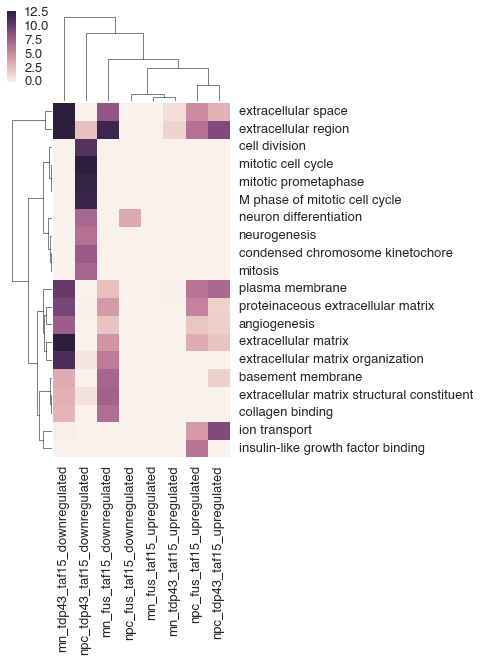

In [70]:
dataviz.plot_go_enrichment(unique_changes, filter_value=1, max_terms=20, figsize=(4, 8))
plt.savefig(os.path.join(img_dir, "double_knockdown_go_enrichment.svg"))
plt.savefig(os.path.join(img_dir, "double_knockdown_go_enrichment.pdf"))

Figure Legend: GO Encirchement for top 20 enriched go terms from genes that are uniquely changing in the double knockdown, but not the single knockdown of TAF15 and either FUS or TDP43

In double knockdowns extra-celleular go terms are also dis-regulated 

In [71]:
unique_changes

GO Term Description  \
                            GO Term Accession                                                      
mn_fus_taf15_downregulated  GO:0005576                                      extracellular region   
                            GO:0005615                                       extracellular space   
                            GO:0005201               extracellular matrix structural constituent   
                            GO:0005604                                         basement membrane   
                            GO:0005518                                          collagen binding   
                            GO:0030198                         extracellular matrix organization   
                            GO:0005788                               endoplasmic reticulum lumen   
                            GO:0031012                                      extracellular matrix   
                            GO:0005581                                                  collagen   
                            GO:0005578                        proteinaceous extracellular matrix   
                            GO:0007596                                         blood coagulation   
                            GO:0090263         positive regulation of canonical Wnt receptor ...   
                            GO:0042060                                             wound healing   
                            GO:0006955                                           immune response   
                            GO:0005667                              transcription factor complex   
                            GO:0050900                                       leukocyte migration   
                            GO:0030324                                          lung development   
                            GO:0001666                                       response to hypoxia   
                            GO:0045944         positive regulation of transcription from RNA ...   
                            GO:0005198                              structural molecule activity   
                            GO:0005886                                           plasma membrane   
                            GO:0005515                                           protein binding   
                            GO:0001525                                              angiogenesis   
                            GO:0007155                                             cell adhesion   
                            GO:0016324                                    apical plasma membrane   
                            GO:0000122         negative regulation of transcription from RNA ...   
                            GO:0016477                                            cell migration   
                            GO:0043234                                           protein complex   
                            GO:0008284                 positive regulation of cell proliferation   
                            GO:0005102                                          receptor binding   
...                                                                                          ...   
npc_tdp43_taf15_upregulated GO:2001213                     negative regulation of vasculogenesis   
                            GO:2001214                     positive regulation of vasculogenesis   
                            GO:2001220         negative regulation of G2 phase of mitotic cel...   
                            GO:2001222                            regulation of neuron migration   
                            GO:2001223                   negative regulation of neuron migration   
                            GO:2001224                   positive regulation of neuron migration   
                            GO:2001234         negative regulation of apoptotic signaling pat...   
                            GO:2001235         positive regulation of apoptot

In [72]:
#ax = dataviz.plot_go_enrichment(unique_changes, filter_value=1, figsize=(30,30))


Figure Legend: GO Encirchement for all enriched go terms from genes that are uniquely changing in the double knockdown, but not the single knockdown of TAF15 and either FUS or TDP43

In [73]:
# mt_sig_go_terms = unique_changes.ix['fus_taf15_upregulated'].ix[[
#                                               #'GO:0042773',
#                                               #'GO:0016266', 
#                                               #'GO:0022904', 
#                                               #'GO:0008137',
#                                               #'GO:0005747',
#                                               #'GO:0005743',
#                                               #'GO:0006120'
#                                               ]]

# mt_sig_gene_names = set([])
# for item in mt_sig_go_terms['Gene symbols in List'].values:
#     mt_sig_gene_names |= set(item.split(","))

# mt_sig_gene_ids = set([])
# for item in mt_sig_go_terms['Ensembl Gene IDs in List'].values:
#     mt_sig_gene_ids |= set(item.split(","))

#Are the mitochonidral Genes Actually Changing

In [74]:
#Count based analysis
# mito_counts = mn_counts.ix[all_counts.index.isin(mito_genes.values())].copy()
# mito_counts = mito_counts.drop(['Chr', 'Strand', 'Start', 'End', 'Length'], axis=1)
# counts = np.log2(mito_counts.mul(1 / mito_counts.Scrm_1, axis=0))
# counts.index = gencode_to_ensembl(counts.index)
# counts  = counts.ix[mt_sig_gene_ids]

# num_samples = len(counts.columns)
# colors = sns.color_palette("Set2", num_samples)

# with dataviz.Figure(os.path.join(img_dir, "gene_expression.svg"), figsize=(30, 10)) as fig:
#     ax = fig.add_subplot(2,2,1)
#     width = .35
#     ind = np.arange(len(counts.FUS_TAF15_shRNA_1)) * ((num_samples + 10) * width)
    
#     for x, (color, col) in enumerate(zip(colors, counts.columns)):
#         ax.bar(ind + (width * x), counts[col], width, label=col, color=color)

#     ax.set_xticks(np.arange(len(counts.index)) * ((num_samples + 10) * width))
#     ax.set_xticklabels(counts.index, rotation=90)
#     ax.legend(loc=0)

In [75]:
mm_rpkm = rpkm.ix['MN']
log2_normalized = np.log2(mn_rpkm / mn_rpkm.ix['MN', 'Scrm_1', 'Scrm', 1])

In [76]:
compared = pd.concat({"fus_taf15": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/fus_taf15.csv", index_col=0),
    "fus_taf15_only": pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/fus_taf15_only.csv", index_col=0)},
          names=['rbp', 'gene'])

series_1 = compared.irow(0)
series_2 = compared.irow(1)

print scipy.stats.linregress(series_1, series_2)
significant_compared = compared[(compared.padj <= .05) & (abs(compared.log2FoldChange) > 1)]

LinregressResult(slope=113.27493685250499, intercept=-74.813273668783836, rvalue=0.99587132728464278, pvalue=2.5533719035432369e-05, stderr=5.1626430996118531)


In [77]:
significant_compared.groupby(level="rbp").count()

,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
rbp,,,,,,
fus_taf15,490,490,490,490,490,490
fus_taf15_only,271,271,271,271,271,271


In [78]:
# mt_result = knockdowns.ix[[gene.split(".")[0] in mt_sig_gene_ids for gene in knockdowns.index.get_level_values(level="gene")]]
# mt_result.log2FoldChange.unstack()

In [79]:
# mito_genes = {name: gene_id for name, gene_id in name_to_gene_id.items() if name.startswith("MT-")}

In [80]:
# mt_rpkm = rpkm[mito_genes.values()]
# mt_rpkm = mt_rpkm.rename(columns=gene_id_to_name)

In [81]:
# interesting_data = pd.concat([mt_rpkm.xs("FUS_TAF15", level="knockdown"), mt_rpkm.xs("Scrm", level="knockdown")])
# interesting_data += 1
# sns.clustermap(np.log10(interesting_data.ix['MN']), figsize=(15,2.0))
# plt.savefig(os.path.join(img_dir, "double_knockdown_rpkm.svg"))
# plt.savefig(os.path.join(img_dir, "double_knockdown_rpkm.pdf"))

In [82]:
# interesting_data = pd.concat([mt_rpkm.xs("FUS_TAF15", level="knockdown"), mt_rpkm.xs("Scrm", level="knockdown")])
# interesting_data = interesting_data.ix['MN'][list(mt_sig_gene_names)] 
# sns.clustermap(interesting_data, figsize=(5, 2.5))
# plt.savefig(os.path.join(img_dir, "significantly_changing_mt_genes.svg"))

#Raw RPKMs

In [83]:
compared.index = pd.MultiIndex.from_tuples([(rbp, gene.split(".")[0]) for rbp, gene in compared.index], names=['rbp', 'gene'])


In [84]:
significant_compared  = compared[(compared.padj <= .05) & (abs(compared.log2FoldChange) > 1)]

In [85]:
# interesting_data = mt_rpkm
# interesting_data = interesting_data.ix['MN'][list(mt_sig_gene_names)] 
# interesting_data = interesting_data.T

# num_samples = len(interesting_data.columns)
# colors = sns.color_palette("Set2", num_samples)
# with dataviz.Figure(os.path.join(img_dir, "gene_expression_rpkm.svg"), figsize=(30, 10)) as fig:
#     ax = fig.add_subplot(2,2,1)
#     width = .35
#     ind = np.arange(len(interesting_data)) * ((num_samples + 10) * width)
    
#     for x, (color, col) in enumerate(zip(colors, interesting_data.columns)):
#         ax.bar(ind + (width * x), interesting_data[col], width, label=col, color=color)

#     ax.set_xticks(np.arange(len(interesting_data.index)) * ((num_samples + 10) * width))
#     ax.set_xticklabels(interesting_data.index, rotation=90)
#     ax.legend(loc=0)
#     ax.set_ylim(0, 50)

#Log2 Fold Change

In [86]:
# scrm_fold = interesting_data.T
# scrm_fold = scrm_fold.div(scrm_fold.ix[["Scrm_1", "Scrm", "1"]].irow(0), axis=1).T
# scrm_fold = np.log2(scrm_fold)

# num_samples = len(scrm_fold.columns)
# colors = sns.color_palette("Set2", num_samples)
# with dataviz.Figure(os.path.join(img_dir, "gene_expression_rpkm.svg"), figsize=(30, 10)) as fig:
#     ax = fig.add_subplot(2,2,1)
#     width = .35
#     ind = np.arange(len(scrm_fold)) * ((num_samples + 10) * width)
    
#     for x, (color, col) in enumerate(zip(colors, scrm_fold.columns)):
#         ax.bar(ind + (width * x), scrm_fold[col], width, label=col, color=color)

#     ax.set_xticks(np.arange(len(scrm_fold.index)) * ((num_samples + 10) * width))
#     ax.set_xticklabels(scrm_fold.index, rotation=90)
#     ax.legend(loc=0)

#Overlaps between iPSC MN data and any of our other datasets

In [87]:
gene_id_to_type_ens = {gene.split(".")[0]: gene_type for gene, gene_type in gene_id_to_type.items()}

In [88]:
mn_expressed_genes = [gene for gene in expressed_genes['mn'] if gene_id_to_type_ens[gene] == 'protein_coding']

In [89]:
len(mn_expressed_genes)

11607

In [90]:
coding_ips_signifcant_downregulated = ips_signifcant_downregulated[[gene_id_to_type[gene] == 'protein_coding' for gene in ips_signifcant_downregulated.index.get_level_values(level="gene")]]
coding_signifcant_downregulated = signifcant_downregulated[[gene_id_to_type[gene] == 'protein_coding' for gene in signifcant_downregulated.index.get_level_values(level="gene")]]
coding_ips_signifcant_upregulated = ips_signifcant_upregulated[[gene_id_to_type[gene] == 'protein_coding' for gene in ips_signifcant_upregulated.index.get_level_values(level="gene")]]
coding_signifcant_upregulated = signifcant_upregulated[[gene_id_to_type[gene] == 'protein_coding' for gene in signifcant_upregulated.index.get_level_values(level="gene")]]

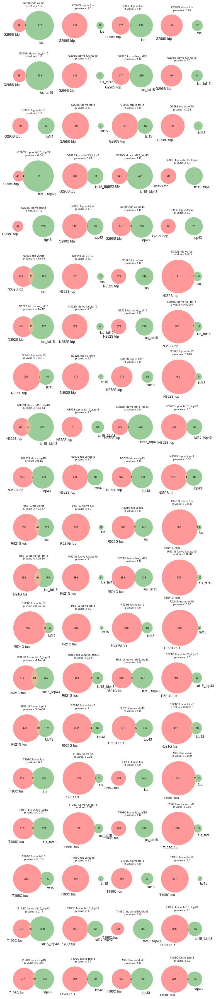

In [91]:
count = 0
row_num = 20
col_num = 4
gs = gridspec.GridSpec(row_num, col_num)
with dataviz.Figure(os.path.join(img_dir, "up_and_down_regulation_overlap_taf15_tdp43.svg"), figsize=(col_num * 2.5, row_num * 2.5)) as fig:
    for (ips_downregulated_name, ips_downregulated_df), (ips_upregulated_name, ips_upregulated_df) in zip(coding_ips_signifcant_downregulated.groupby(level=['rbp', 'mutation']), 
                                                                                                          coding_ips_signifcant_upregulated.groupby(level=['rbp', 'mutation'])):
        for (cell_downregulated_name, cell_downregulated_df), (cell_upregulated_name, cell_upregulated_df) in zip(coding_signifcant_downregulated.ix['mn'].groupby(level=["rbp"]),
                                                                                                                  coding_signifcant_upregulated.ix['mn'].groupby(level=["rbp"])):


            ips_down = set(ips_downregulated_df.ix[ips_downregulated_name].index.get_level_values(level='gene'))
            cell_down = set(cell_downregulated_df.ix[cell_downregulated_name].index.get_level_values(level='gene'))

            ips_up = set(ips_upregulated_df.ix[ips_upregulated_name].index.get_level_values(level='gene'))
            cell_up = set(cell_upregulated_df.ix[cell_upregulated_name].index.get_level_values(level='gene'))


            p_value_down = min(hypergeom.sf(len(ips_down & cell_down), len(mn_expressed_genes), len(ips_down), len(cell_down)) * 20, 1.0)
            p_value_up = min(hypergeom.sf(len(ips_up & cell_up), len(mn_expressed_genes), len(ips_up), len(cell_up)) * 20, 1.0)

            p_value_down_up = min(hypergeom.sf(len(ips_down & cell_up), len(mn_expressed_genes), len(ips_down), len(cell_up)) * 20, 1.0)
            p_value_up_down = min(hypergeom.sf(len(ips_up & cell_down), len(mn_expressed_genes), len(ips_up), len(cell_down)) * 20, 1.0)

            ax = fig.add_subplot(gs[count, 0])
            venn2([ips_down,
                   cell_down,
                   ], set_labels=(" ".join(ips_downregulated_name), cell_downregulated_name), ax =ax )
            ax.set_title("{} vs {}\n p-value < {:.2}".format(" ".join(ips_downregulated_name), 
                                                             cell_downregulated_name,
                                                             p_value_down), fontsize=10)

            ax = fig.add_subplot(gs[count, 1])
            venn2([ips_up,
                   cell_up,
                   ], set_labels=(" ".join(ips_upregulated_name), cell_upregulated_name), ax =ax )
            ax.set_title("{} vs {}\n p-value < {:.2}".format(" ".join(ips_upregulated_name), 
                                                             cell_upregulated_name,
                                                             p_value_up), fontsize=10)
            
            ax = fig.add_subplot(gs[count, 2])
            venn2([ips_up,
                   cell_down,
                   ], set_labels=(" ".join(ips_upregulated_name), cell_upregulated_name), ax =ax )
            ax.set_title("{} vs {}\n p-value < {:.2}".format(" ".join(ips_upregulated_name), 
                                                             cell_upregulated_name,
                                                             p_value_up_down), fontsize=10)
            
            ax = fig.add_subplot(gs[count, 3])
            venn2([ips_down,
                   cell_up,
                   ], set_labels=(" ".join(ips_upregulated_name), cell_upregulated_name), ax =ax )
            ax.set_title("{} vs {}\n p-value < {:.2}".format(" ".join(ips_upregulated_name), 
                                                             cell_upregulated_name,
                                                             p_value_down_up), fontsize=10)
            
            count += 1


In [92]:
img_dir

'/nas3/gpratt/Dropbox/TAF15/Data/MN_data/GP_analysis_RNAseq/'

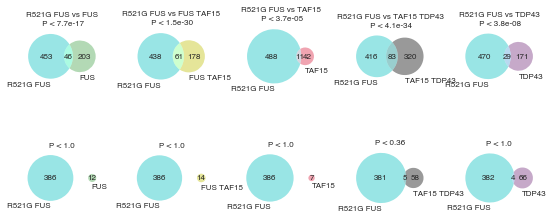

In [93]:
count = 0
row_num = 2
col_num = 5


with dataviz.Figure(os.path.join(img_dir, "r521g_mn_venns.svg"), figsize=(col_num * 1.5, row_num * 2.0)) as fig:
    gs = gridspec.GridSpec(row_num, col_num)
    for (ips_downregulated_name, ips_downregulated_df), (ips_upregulated_name, ips_upregulated_df) in zip(coding_ips_signifcant_downregulated.groupby(level=['rbp', 'mutation']), 
                                                                                                          coding_ips_signifcant_upregulated.groupby(level=['rbp', 'mutation'])):
        for (cell_downregulated_name, cell_downregulated_df), (cell_upregulated_name, cell_upregulated_df) in zip(coding_signifcant_downregulated.ix['mn'].groupby(level=["rbp"]),
                                                                                                                  coding_signifcant_upregulated.ix['mn'].groupby(level=["rbp"])):
            if ips_downregulated_name[0] not in ['R521G']:
                continue
            
            ips_down = set(ips_downregulated_df.ix[ips_downregulated_name].index.get_level_values(level='gene'))
            cell_down = set(cell_downregulated_df.ix[cell_downregulated_name].index.get_level_values(level='gene'))

            ips_up = set(ips_upregulated_df.ix[ips_upregulated_name].index.get_level_values(level='gene'))
            cell_up = set(cell_upregulated_df.ix[cell_upregulated_name].index.get_level_values(level='gene'))
            

            p_value_down = min(hypergeom.sf(len(ips_down & cell_down), len(mn_expressed_genes), len(ips_down), len(cell_down)) * 20, 1.0)
            p_value_up = min(hypergeom.sf(len(ips_up & cell_up), len(mn_expressed_genes), len(ips_up), len(cell_up)) * 20, 1.0)
                        
            ax = fig.add_subplot(gs[0, count])
            venn = venn2([ips_down, cell_down,], 
                  set_labels=(" ".join(ips_downregulated_name).upper(), rbp_names[cell_downregulated_name]),
                  set_colors=(rbp_colors[ips_downregulated_name[0]], rbp_colors[cell_downregulated_name]), 
                  ax=ax)

            ax.set_title("{} vs {}\n P < {:.2}".format(" ".join(ips_downregulated_name).upper(), 
                                                             rbp_names[cell_downregulated_name],
                                                             p_value_down), fontsize=8)
            
            [label.set_fontsize(8) for label in venn.subset_labels if label is not None]
            [label.set_fontsize(8) for label in venn.set_labels]

            
                
            ax = fig.add_subplot(gs[1, count])
            venn = venn2([ips_up, cell_up,], 
                  set_labels=(" ".join(ips_upregulated_name).upper(), rbp_names[cell_upregulated_name]),
                  set_colors=(rbp_colors[ips_downregulated_name[0]], rbp_colors[cell_downregulated_name]), 

                  ax =ax )
            #{} vs {}\n
            ax.set_title("P < {:.2}".format(#" ".join(ips_upregulated_name).upper(), 
                                             #                rbp_names[cell_upregulated_name],
                                                             p_value_up), fontsize=8)
            
            [label.set_fontsize(8) for label in venn.subset_labels if label is not None]
            [label.set_fontsize(8) for label in venn.set_labels]
            count += 1
            


#Get GO terms for overlapping Genes

In [205]:
result = {}
for (ips_downregulated_name, ips_downregulated_df), (ips_upregulated_name, ips_upregulated_df) in zip(coding_ips_signifcant_downregulated.groupby(level=['rbp', 'mutation']), 
                                                                                                      coding_ips_signifcant_upregulated.groupby(level=['rbp', 'mutation'])):
    for (cell_downregulated_name, cell_downregulated_df), (cell_upregulated_name, cell_upregulated_df) in zip(coding_signifcant_downregulated.ix['mn'].groupby(level=["rbp"]),
                                                                                                              coding_signifcant_upregulated.ix['mn'].groupby(level=["rbp"])):
        if ips_downregulated_name[0] not in ['R521G']:
            continue

        ips_down = set(ips_downregulated_df.ix[ips_downregulated_name].index.get_level_values(level='gene'))
        cell_down = set(cell_downregulated_df.ix[cell_downregulated_name].index.get_level_values(level='gene'))

        ips_up = set(ips_upregulated_df.ix[ips_upregulated_name].index.get_level_values(level='gene'))
        cell_up = set(cell_upregulated_df.ix[cell_upregulated_name].index.get_level_values(level='gene'))

        merged_down = ips_down & cell_down 
        merged_up = ips_up & cell_up 
        result[(ips_downregulated_name[0], cell_downregulated_name, "down")] = hg19go.enrichment(gencode_to_ensembl(merged_down), background=expressed_genes['mn'])
        result[(ips_upregulated_name[0], cell_upregulated_name, "up")] = hg19go.enrichment(gencode_to_ensembl(merged_up), background=expressed_genes['mn'])
result = pd.concat(result, names=['mutation', 'kd', 'direction'])
result = result[result['Bonferroni-corrected Hypergeometric p-Value'] < .05]

In [207]:
HTML(result.xs("down", level='direction').to_html())

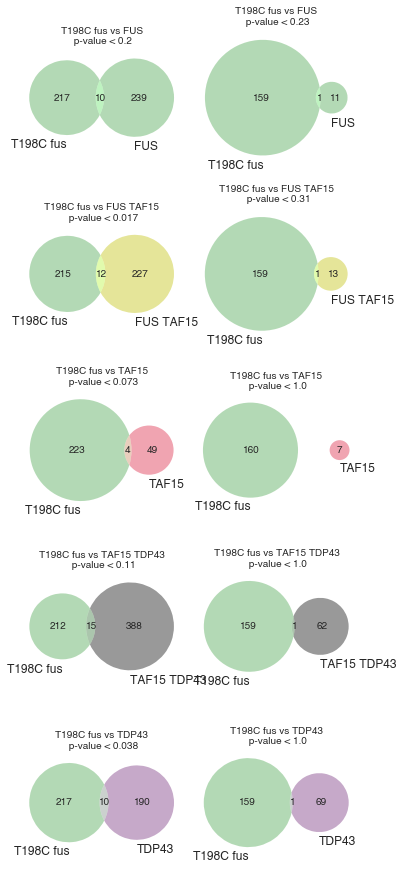

In [94]:
count = 0
row_num = 5
col_num = 2


with dataviz.Figure(os.path.join(img_dir, "t192c_venns.svg"), figsize=(col_num * 2.5, row_num * 2.5)) as fig:
    for (ips_downregulated_name, ips_downregulated_df), (ips_upregulated_name, ips_upregulated_df) in zip(coding_ips_signifcant_downregulated.groupby(level=['rbp', 'mutation']), 
                                                                                                          coding_ips_signifcant_upregulated.groupby(level=['rbp', 'mutation'])):
        for (cell_downregulated_name, cell_downregulated_df), (cell_upregulated_name, cell_upregulated_df) in zip(coding_signifcant_downregulated.ix['mn'].groupby(level=["rbp"]),
                                                                                                                  coding_signifcant_upregulated.ix['mn'].groupby(level=["rbp"])):
            if ips_downregulated_name[0] not in ['T198C']:
                continue

            count += 1

            ips_down = set(ips_downregulated_df.ix[ips_downregulated_name].index.get_level_values(level='gene'))
            cell_down = set(cell_downregulated_df.ix[cell_downregulated_name].index.get_level_values(level='gene'))

            ips_up = set(ips_upregulated_df.ix[ips_upregulated_name].index.get_level_values(level='gene'))
            cell_up = set(cell_upregulated_df.ix[cell_upregulated_name].index.get_level_values(level='gene'))


            p_value_down = min(hypergeom.sf(len(ips_down & cell_down), len(mn_expressed_genes), len(ips_down), len(cell_down)) * 20, 1.0)
            p_value_up = min(hypergeom.sf(len(ips_up & cell_up), len(mn_expressed_genes), len(ips_up), len(cell_up)) * 20, 1.0)

            ax = fig.add_subplot(row_num,col_num,count)
            venn2([ips_down, cell_down,], 
                  set_labels=(" ".join(ips_downregulated_name), rbp_names[cell_downregulated_name]),
                  set_colors=(rbp_colors[ips_downregulated_name[1]], rbp_colors[cell_downregulated_name]), 
                  ax=ax)

            ax.set_title("{} vs {}\n p-value < {:.2}".format(" ".join(ips_downregulated_name), 
                                                             rbp_names[cell_downregulated_name],
                                                             p_value_down), fontsize=10)

            count +=1
            ax = fig.add_subplot(row_num,col_num,count)
            venn2([ips_up, cell_up,], 
                  set_labels=(" ".join(ips_upregulated_name), rbp_names[cell_upregulated_name]),
                  set_colors=(rbp_colors[ips_downregulated_name[1]], rbp_colors[cell_downregulated_name]), 

                  ax =ax )
            ax.set_title("{} vs {}\n p-value < {:.2}".format(" ".join(ips_upregulated_name), 
                                                             rbp_names[cell_upregulated_name],
                                                             p_value_up), fontsize=10)

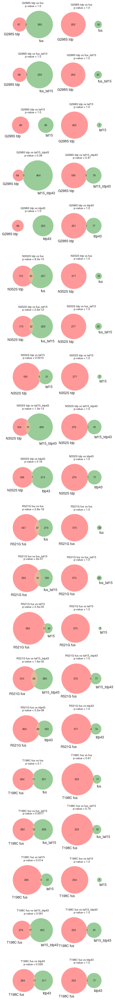

In [95]:
count = 0
row_num = 20
col_num =2

overlapping = {}
with dataviz.Figure(os.path.join(img_dir, "up_and_down_regulation_overlap_taf15_tdp43.svg"), figsize=(col_num * 2.5, row_num * 2.5)) as fig:
    for (ips_downregulated_name, ips_downregulated_df), (ips_upregulated_name, ips_upregulated_df) in zip(ips_signifcant_downregulated.groupby(level=['rbp', 'mutation']), 
                                                                                                          ips_signifcant_upregulated.groupby(level=['rbp', 'mutation'])):
        for (cell_downregulated_name, cell_downregulated_df), (cell_upregulated_name, cell_upregulated_df) in zip(signifcant_downregulated.ix['mn'].groupby(level=["rbp"]),
                                                                                                                  signifcant_upregulated.ix['mn'].groupby(level=["rbp"])):

            count += 1

            ips_down = set(ips_downregulated_df.ix[ips_downregulated_name].index.get_level_values(level='gene'))
            cell_down = set(cell_downregulated_df.ix[cell_downregulated_name].index.get_level_values(level='gene'))

            ips_up = set(ips_upregulated_df.ix[ips_upregulated_name].index.get_level_values(level='gene'))
            cell_up = set(cell_upregulated_df.ix[cell_upregulated_name].index.get_level_values(level='gene'))


            p_value_down = min(hypergeom.sf(len(ips_down & cell_down), len(expressed_genes['mn']), len(ips_down), len(cell_down)) * 20, 1.0)
            p_value_up = min(hypergeom.sf(len(ips_up & cell_up), len(expressed_genes['mn']), len(ips_up), len(cell_up)) * 20, 1.0)
            rbp, cell_type = ips_downregulated_name
            overlapping[(rbp, cell_type, cell_downregulated_name)] = Counter(ips_down & cell_down)
            ax = fig.add_subplot(row_num,col_num,count)
            venn2([ips_down,
                   cell_down,
                   ], set_labels=(" ".join(ips_downregulated_name), cell_downregulated_name), ax =ax )
            ax.set_title("{} vs {}\n p-value < {:.2}".format(" ".join(ips_downregulated_name), 
                                                             cell_downregulated_name,
                                                             p_value_down), fontsize=10)

            count +=1
            ax = fig.add_subplot(row_num,col_num,count)
            venn2([ips_up,
                   cell_up,
                   ], set_labels=(" ".join(ips_upregulated_name), cell_upregulated_name), ax =ax )
            ax.set_title("{} vs {}\n p-value < {:.2}".format(" ".join(ips_upregulated_name), 
                                                             cell_upregulated_name,
                                                             p_value_up), fontsize=10)

In [96]:
overlapping = pd.DataFrame(overlapping).fillna(0)
overlapping.index = [gene_id_to_name[gene_id] for gene_id in overlapping.index]

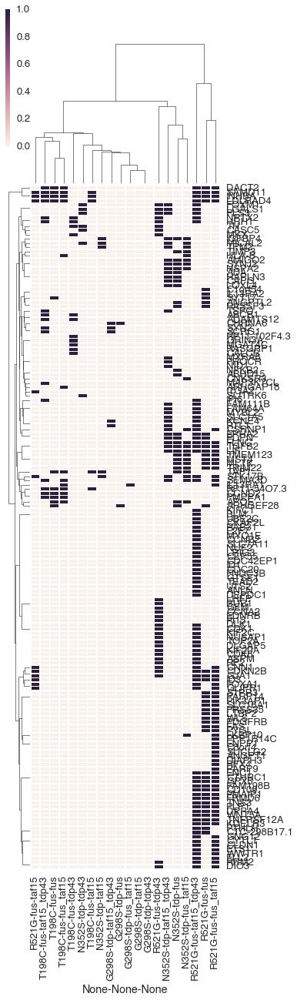

In [97]:
sns.clustermap(overlapping, figsize=(5,20), linewidth=.1)

In [98]:
from matplotlib import pyplot as mpl

In [99]:
overlapping

G298S                                   N352S                  \
               tdp                                     tdp                   
               fus fus_taf15 taf15 taf15_tdp43 tdp43   fus fus_taf15 taf15   
TNFRSF12A        0         0     0           0     0     0         0     0   
ANLN             0         0     0           0     0     0         0     0   
WWTR1            0         0     0           0     0     0         0     0   
DEPDC1           0         0     0           0     0     0         0     0   
FAS              0         0     0           0     0     0         0     0   
CAPG             0         0     0           0     0     1         0     0   
UTS2             0         0     0           0     0     0         0     0   
ASPM             0         0     0           0     0     0         0     0   
TEAD2            0         0     0           0     0     0         0     0   
GTSE1            0         0     0           0     0     0         0     0   
FNDC3B           0         0     0           0     0     0         0     0   
NFKB2            0         0     0           0     0     1         0     0   
SYNJ2            0         0     0           0     0     1         1     0   
STK17B           0         0     0           0     0     0         1     1   
ABCB1            0         0     0           0     0     0         0     0   
PTHLH            0         0     0           0     0     0         0     0   
MLTK             0         0     0           0     0     1         1     0   
TGFB2            0         0     0           0     0     1         1     0   
LGALS1           0         0     0           0     0     0         0     0   
KDELR3           0         0     0           0     0     0         0     0   
TIMP3            0         0     0           0     0     1         1     0   
TSPO             0         0     0           0     0     0         0     0   
PYGL             0         0     0           0     0     0         0     0   
PROCR            0         0     0           0     0     0         0     0   
MYBL2            0         0     0           0     0     0         0     0   
PLS3             0         0     0           0     0     0         0     0   
RP2              0         0     0           0     0     0         0     0   
SYT17            0         0     0           0     0     0         0     0   
SLC1A5           0         0     0           0     0     0         0     0   
CDK6             0         0     0           0     0     0         0     0   
...            ...       ...   ...         ...   ...   ...       ...   ...   
SUCLG2           0         0     0           0     0     0         0     0   
GNG12            0         0     0           0     0     0         0     0   
RASGRP1          0         0     0           0     0     0         0     0   
PARP14           0         0     0           0     0     0         0     0   
UBE2C            0         0     0           0     0     0         0     0   
CALCB            0         0     0           0     0     0         0     0   
CTC-298B17.1     0         0     0           0     0     0         0     0   
C8orf4           0         0     0           0     0     0         0     0   
TH               0         0     0           0     0     0         0     0   
MGAT4C           0         0     0           0     0     0         0     0   
LHFP             0         0     0           0     0     0         0     0   
SLITRK6          0         0     0           0     0     0         0     0   
DLK1             0         0     0           0     0     0         0     0   
SAMD11           0         0     0           0     0     0         0     0   
FAM111B          0         0     0           0     0     0         0     0   
HRH1             0         0     0           0     0     0         0     0   
ADA              0         0     0           0     0     1         0     0   
BLM              0         0     0 

In [100]:
overlapping_filtered = overlapping.T.xs("R521G", level=0).T
overlapping_filtered = overlapping_filtered[overlapping_filtered.sum(axis=1) > 1]
overlapping_filtered = overlapping_filtered.T.ix["fus"].T
overlapping_filtered.columns = [rbp_names[rbp] for rbp in overlapping_filtered.columns]

only_fus_taf15 = overlapping_filtered[['FUS', "TAF15", "FUS TAF15"]]
only_fus_taf15 = only_fus_taf15[only_fus_taf15.sum(axis=1) >= 1]

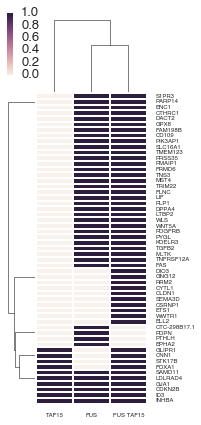

In [101]:
sns.clustermap(only_fus_taf15, figsize=(2.5,7), linewidth=.5)
fig = mpl.gcf()
heatmap = fig.axes[2]
[tick.set_fontsize(6) for tick in heatmap.get_xticklabels()]
[tick.set_fontsize(6) for tick in heatmap.get_yticklabels()]
[tick.set_rotation(0) for tick in heatmap.get_xticklabels()]

fig.savefig(os.path.join(img_dir, "overlapping_r521g_genes.svg"))

This is odd, it looks like I'm getting stuff in the TGF-beta pathway, TGFB2 and DACT2 at least, others maybe, Lif is ringing a bell

Figure Legend: Overlap between TAF15 Knockdowns in either MN or NPC and patient direct iPSC NPCs with known ALS mutati

In [102]:
introns = pybedtools.BedTool("/nas3/gpratt/clipper/clipper/data/regions/hg19_introns.bed")
intron_df = introns.to_dataframe()
intron_df['intron_length'] = intron_df.end - intron_df.start

#Look at intron length distributions


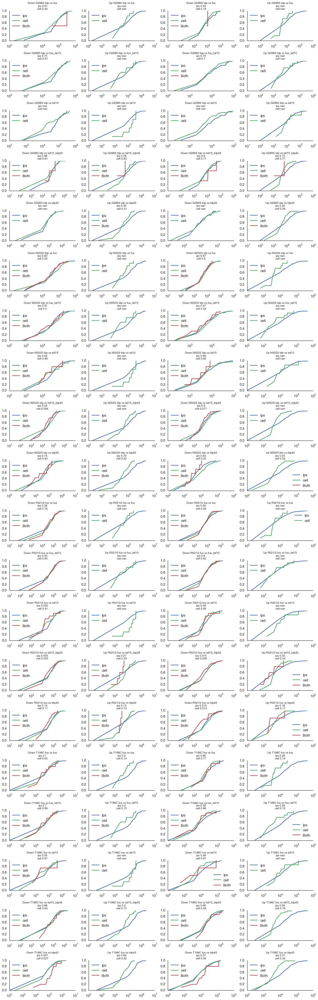

In [103]:
result = {}
count = 0
num_rows = 20
num_cols = 4
gs = gridspec.GridSpec(num_rows, num_cols)

with dataviz.Figure(os.path.join(img_dir, "up_and_down_regulation_overlap_taf15_tdp43.svg"), figsize=(col_num * 8, row_num * 2.5)) as fig:

    for (ips_downregulated_name, ips_downregulated_df), (ips_upregulated_name, ips_upregulated_df) in zip(coding_ips_signifcant_downregulated.groupby(level=['rbp', 'mutation']), 
                                                                                                          coding_ips_signifcant_upregulated.groupby(level=['rbp', 'mutation'])):
        for (cell_downregulated_name, cell_downregulated_df), (cell_upregulated_name, cell_upregulated_df) in zip(coding_signifcant_downregulated.ix['mn'].groupby(level=["rbp"]),
                                                                                                                  coding_signifcant_upregulated.ix['mn'].groupby(level=["rbp"])):
           
            ips_down = set(ips_downregulated_df.ix[ips_downregulated_name].index.get_level_values(level='gene'))
            cell_down = set(cell_downregulated_df.ix[cell_downregulated_name].index.get_level_values(level='gene'))
            both_down = ips_down & cell_down

            ips_up = set(ips_upregulated_df.ix[ips_upregulated_name].index.get_level_values(level='gene'))
            cell_up = set(cell_upregulated_df.ix[cell_upregulated_name].index.get_level_values(level='gene'))
            both_up = ips_up & cell_up
            
            ax = fig.add_subplot(gs[count, 0])
            both_down_len = intron_df[intron_df.name.isin(both_down)].groupby("name").intron_length.sum()
            down_ips_len = intron_df[intron_df.name.isin(ips_down)].groupby("name").intron_length.sum()
            down_cell_len = intron_df[intron_df.name.isin(cell_down)].groupby("name").intron_length.sum()
            
            dataviz.plot_cdf(down_ips_len, label="ips", ax=ax)
            dataviz.plot_cdf(down_cell_len, label="cell", ax=ax)
            if len(both_down_len) > 0:
                dataviz.plot_cdf(both_down_len, label="Both", ax=ax)
                
            ips_down_p_value = ks_2samp(both_down_len, down_ips_len)[1]
            cell_down_p_value = ks_2samp(both_down_len, down_cell_len)[1]
            ax.set_title("Down {} vs {}\nips {:.2}\ncell {:.2}".format(" ".join(ips_downregulated_name), 
                                                                  cell_downregulated_name,
                                                                  ips_down_p_value,
                                                                  cell_down_p_value
                                                                 ), 
                         fontsize=10
                        )
            ax.set_xscale("log")
            ax.legend(loc=0)
            sns.despine(ax=ax)
            
            ax = fig.add_subplot(gs[count, 1])
            both_up_len = intron_df[intron_df.name.isin(both_up)].groupby("name").intron_length.sum()
            both_up_len = intron_df[intron_df.name.isin(both_up)].groupby("name").intron_length.sum()
            up_ips_len = intron_df[intron_df.name.isin(ips_up)].groupby("name").intron_length.sum()
            up_cell_len = intron_df[intron_df.name.isin(cell_up)].groupby("name").intron_length.sum()
            dataviz.plot_cdf(up_ips_len, label="ips", ax=ax)
            dataviz.plot_cdf(up_cell_len, label="cell",ax=ax)           
            if len(both_up_len) > 0:
                dataviz.plot_cdf(both_up_len, label="Both", ax=ax)
                
            ips_up_p_value = ks_2samp(both_up_len, down_ips_len)[1]
            cell_up_p_value = ks_2samp(both_up_len, down_cell_len)[1]
            ax.set_title("Up {} vs {}\nips {:.2}\ncell {:.2}".format(" ".join(ips_upregulated_name), 
                                                                  cell_upregulated_name,
                                                                  ips_up_p_value,
                                                                  cell_up_p_value
                                                                 ), 
                         fontsize=10
                        )
            ax.set_xscale("log")
            ax.legend(loc=0)
            sns.despine(ax=ax)
            
            ax = fig.add_subplot(gs[count, 2])
            both_down_len = intron_df[intron_df.name.isin(both_down)].groupby("name").intron_length.mean()
            down_ips_len = intron_df[intron_df.name.isin(ips_down)].groupby("name").intron_length.mean()
            down_cell_len = intron_df[intron_df.name.isin(cell_down)].groupby("name").intron_length.mean()
            dataviz.plot_cdf(down_ips_len, label="ips", ax=ax)
            dataviz.plot_cdf(down_cell_len, label="cell", ax=ax)           
            if len(both_down_len) > 0:
                dataviz.plot_cdf(both_down_len, label="Both", ax=ax)
                
            ips_down_p_value = ks_2samp(both_down_len, down_ips_len)[1]
            cell_down_p_value = ks_2samp(both_down_len, down_cell_len)[1]
            ax.set_title("Down {} vs {}\nips {:.2}\ncell {:.2}".format(" ".join(ips_downregulated_name), 
                                                                  cell_downregulated_name,
                                                                  ips_down_p_value,
                                                                  cell_down_p_value
                                                                 ), 
                         fontsize=10
                        )
            ax.set_xscale("log")
            ax.legend(loc=0)
            sns.despine(ax=ax)
            
            ax = fig.add_subplot(gs[count, 3])
            both_up_len = intron_df[intron_df.name.isin(both_up)].groupby("name").intron_length.mean()
            up_ips_len = intron_df[intron_df.name.isin(ips_up)].groupby("name").intron_length.mean()
            up_cell_len = intron_df[intron_df.name.isin(cell_up)].groupby("name").intron_length.mean()
            dataviz.plot_cdf(up_ips_len, label="ips", ax=ax)
            dataviz.plot_cdf(up_cell_len, label="cell",ax=ax)
            if len(both_up_len) > 0:
                dataviz.plot_cdf(both_up_len, label="Both", ax=ax)
                
            ips_up_p_value = ks_2samp(both_up_len, down_ips_len)[1]
            cell_up_p_value = ks_2samp(both_up_len, down_cell_len)[1]
            ax.set_title("Up {} vs {}\nips {:.2}\ncell {:.2}".format(" ".join(ips_upregulated_name), 
                                                                  cell_upregulated_name,
                                                                  ips_up_p_value,
                                                                  cell_up_p_value
                                                                 ), 
                         fontsize=10
                        )
            ax.set_xscale("log")
            ax.legend(loc=0)
            sns.despine(ax=ax)
            
            count += 1

#Do go analysis of overlapping genes beween KD and mutants

In [104]:
result = {}
for (ips_downregulated_name, ips_downregulated_df), (ips_upregulated_name, ips_upregulated_df) in zip(coding_ips_signifcant_downregulated.groupby(level=['rbp', 'mutation']), 
                                                                                                      coding_ips_signifcant_upregulated.groupby(level=['rbp', 'mutation'])):
    for (cell_downregulated_name, cell_downregulated_df), (cell_upregulated_name, cell_upregulated_df) in zip(coding_signifcant_downregulated.ix['mn'].groupby(level=["rbp"]),
                                                                                                              coding_signifcant_upregulated.ix['mn'].groupby(level=["rbp"])):
        ips_down = set(ips_downregulated_df.ix[ips_downregulated_name].index.get_level_values(level='gene'))
        cell_down = set(cell_downregulated_df.ix[cell_downregulated_name].index.get_level_values(level='gene'))

        ips_up = set(ips_upregulated_df.ix[ips_upregulated_name].index.get_level_values(level='gene'))
        cell_up = set(cell_upregulated_df.ix[cell_upregulated_name].index.get_level_values(level='gene'))

        result[('down', "_".join(ips_downregulated_name), cell_downregulated_name)] = hg19go.enrichment(gencode_to_ensembl(ips_down & cell_down), background=mn_expressed_genes)
        result[('up', "_".join(ips_upregulated_name), cell_upregulated_name)] = hg19go.enrichment(gencode_to_ensembl(ips_up & cell_up), background=mn_expressed_genes)
mutant_overlap = pd.concat(result, names=["direction", "foo", 'GO Term ID']).dropna()

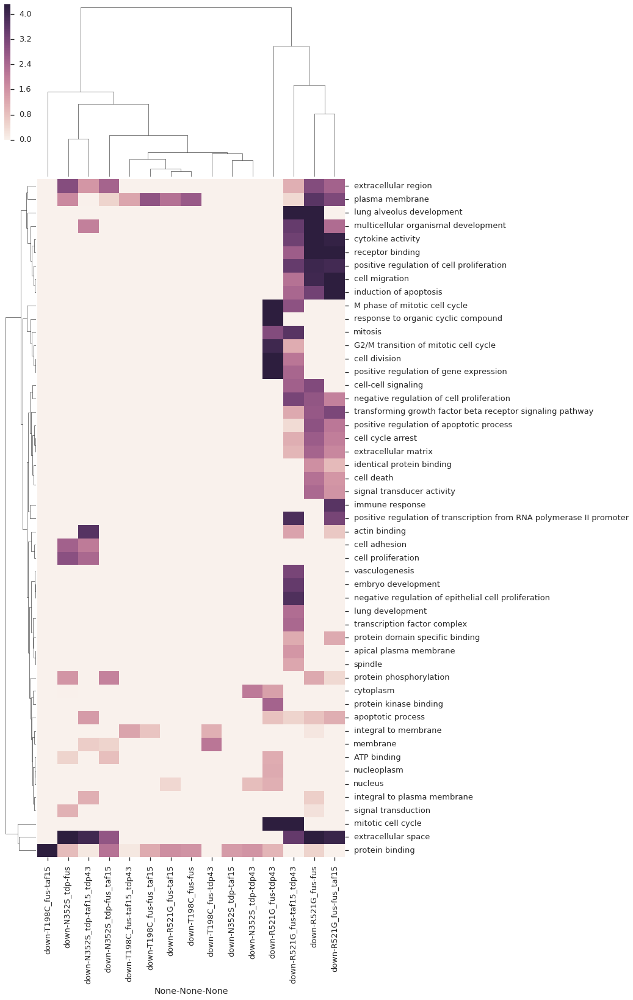

In [216]:
ax = dataviz.plot_go_enrichment(mutant_overlap, filter_value=1, figsize=(10,25))

#Splcing Analysis

In [ ]:
!scp tscc-login1.sdsc.edu:/home/gpratt/projects/fet_family/analysis/human_mn_v1/miso/foo.csv .

In [ ]:
all_splicing_events = pd.read_csv("/nas3/gpratt/projects/fet_family/analysis/human_mn_v1/miso/miso_diff_merged.csv", index_col=[0,1,2])

new_index = []
for rbp, factor, event in all_splicing_events.index:
    splice_type = factor.split("_")[-1]
    
    rbp, control = factor.split("vs")
    rbp_rep = rbp.split("_")[-1]
    rbp = "_".join(rbp.split("_")[:-2])
    control_rep = control.split("_")[-2]
    new_index.append([rbp, rbp_rep, control_rep, splice_type, event])
all_splicing_events.index = pd.MultiIndex.from_tuples(new_index, names=['rbp', 'rbp_rep', "control_rep", "splice_type", 'event'])

#How should I should I filter differental splicing Analysis?

In [ ]:
with dataviz.Figure(os.path.join(img_dir, "miso_descriptives.svg"), figsize=(10, 5)) as fig:
    ax = fig.add_subplot(1,2,1)
    ax.hist(all_splicing_events.bayes_factor[all_splicing_events.bayes_factor < 30], bins=100)
    ax.set_title("Bayes Factor")
    
    ax = fig.add_subplot(1,2,2)
    ax.hist(all_splicing_events['diff'], bins=100)
    ax.set_title("Delta Psi")

I'll set an arbitary filter at Bayse factor > 3 and differental splicing > .25

In [ ]:
significant_splicing_events = all_splicing_events[(all_splicing_events.bayes_factor > 2) & (abs(all_splicing_events['diff']) > .20)]
inclusion_splicing_events = significant_splicing_events[significant_splicing_events['diff'] > 0]
exclusion_splicing_events = significant_splicing_events[significant_splicing_events['diff'] < 0]


result = []
for item in significant_splicing_events.index:
    try:
        result.append(name_to_gene_id[mn_study.splicing.feature_renamer_series[item[4]]])
    except:
        result.append(item[3])
significant_splicing_events['target_gene'] = result


result = []
for item in exclusion_splicing_events.index:
     try:
        result.append(name_to_gene_id[mn_study.splicing.feature_renamer_series[item[4]]])
     except:
         result.append(item[3])
exclusion_splicing_events['target_gene'] = result

result = []
for item in inclusion_splicing_events.index:
    try:
        result.append(name_to_gene_id[mn_study.splicing.feature_renamer_series[item[4]]])
    except:
        result.append(item[3])
inclusion_splicing_events['target_gene'] = result


#Are there major shifts in inclusion / exclusion for different splice types?


In [ ]:
HTML(pd.concat({"all": significant_splicing_events.groupby(level=['rbp', 'rbp_rep', 'control_rep', 'splice_type']).count()['sample1_posterior_mean'],
            "included": inclusion_splicing_events.groupby(level=['rbp', 'rbp_rep', 'control_rep',  'splice_type']).count()['sample1_posterior_mean'],
            "excluded": exclusion_splicing_events.groupby(level=['rbp', 'rbp_rep', 'control_rep',  'splice_type']).count()['sample1_posterior_mean'],}).unstack(level=0).to_html())

Doesn't look like it

#Stringent Filtering for human MN data, what are the reprducable changes?

In [ ]:
significant_splicing_events.groupby(level=['rbp', 'splice_type', 'event']).mean()[(significant_splicing_events.groupby(level=['rbp', 'splice_type', 'event']).count() >= 4).sample1_posterior_mean]

In [ ]:
confident_inclusion_splicing_events = inclusion_splicing_events.groupby(level=['rbp', 'splice_type', 'event']).first()[(inclusion_splicing_events.groupby(level=['rbp', 'splice_type', 'event']).count() >= 4).sample1_posterior_mean]

In [ ]:
confident_inclusion_splicing_events

In [ ]:
confident_exclusion_splicing_events = exclusion_splicing_events.groupby(level=['rbp', 'splice_type', 'event']).first()[(exclusion_splicing_events.groupby(level=['rbp', 'splice_type', 'event']).count() >= 4).sample1_posterior_mean]

In [ ]:
confident_exclusion_splicing_events

#What are the overlaps between splicing events?

In [ ]:
confident_exclusion_splicing_events.ix['TAF15'].target_gene

In [ ]:
set(confident_exclusion_splicing_events.ix['TAF15'].target_gene)

In [ ]:
with dataviz.Figure(os.path.join(img_dir, "inclusion_exclusion_splicing_overlap.svg"), figsize=(10, 5)) as fig:
    ax = fig.add_subplot(2,2,1)
    venn3([confident_exclusion_splicing_events.ix['TAF15'].index,
    confident_exclusion_splicing_events.ix['FUS'].index,
    confident_exclusion_splicing_events.ix['TDP43'].index,],
            set_labels=("TAF15", "FUS", "TDP43"), ax =ax )
    ax.set_title("Overlapping Exclusion Events")
    
    ax = fig.add_subplot(2,2,2)
    venn3([confident_inclusion_splicing_events.ix['TAF15'].index,
           confident_inclusion_splicing_events.ix['FUS'].index,
           confident_inclusion_splicing_events.ix['TDP43'].index,],
            set_labels=("TAF15", "FUS", "TDP43"), ax =ax )
    ax.set_title("Overlapping Inclusion Events")
        
    ax = fig.add_subplot(2,2,3)
    venn3([set(confident_exclusion_splicing_events.ix['TAF15'].target_gene),
    set(confident_exclusion_splicing_events.ix['FUS'].target_gene),
    set(confident_exclusion_splicing_events.ix['TDP43'].target_gene),],
            set_labels=("TAF15", "FUS", "TDP43"), ax =ax )
    ax.set_title("Overlapping Exclusion Genes")
    
    ax = fig.add_subplot(2,2,4)
    venn3([set(confident_inclusion_splicing_events.ix['TAF15'].target_gene),
           set(confident_inclusion_splicing_events.ix['FUS'].target_gene),
           set(confident_inclusion_splicing_events.ix['TDP43'].target_gene),],
            set_labels=("TAF15", "FUS", "TDP43"), ax =ax )
    ax.set_title("Overlapping Inclusion Genes")

In [ ]:
with dataviz.Figure(os.path.join(img_dir, "inclusion_exclusion_splicing_overlap_fus_taf15.svg"), figsize=(10, 5)) as fig:
    ax = fig.add_subplot(2,2,1)
    venn3([confident_exclusion_splicing_events.ix['TAF15'].mRNA_starts.index,
    confident_exclusion_splicing_events.ix['FUS'].mRNA_starts.index,
    confident_exclusion_splicing_events.ix['FUS_TAF15'].mRNA_starts.index,],
            set_labels=("TAF15", "FUS", "FUS TAF15"), ax =ax )
    ax.set_title("Overlapping Exclusion Events")
    
    ax = fig.add_subplot(2,2,2)
    venn3([confident_inclusion_splicing_events.ix['TAF15'].index,
           confident_inclusion_splicing_events.ix['FUS'].index,
           confident_inclusion_splicing_events.ix['FUS_TAF15'].index,],
            set_labels=("TAF15", "FUS", "FUS TAF15"), ax =ax )
    ax.set_title("Overlapping Inclusion Events")
    
    ax = fig.add_subplot(2,2,3)
    venn3([set(confident_exclusion_splicing_events.ix['TAF15'].target_gene),
    set(confident_exclusion_splicing_events.ix['FUS'].target_gene),
    set(confident_exclusion_splicing_events.ix['FUS_TAF15'].target_gene),],
            set_labels=("TAF15", "FUS", "FUS TAF15"), ax =ax )
    ax.set_title("Overlapping Exclusion Genes")
    
    ax = fig.add_subplot(2,2,4)
    venn3([set(confident_inclusion_splicing_events.ix['TAF15'].target_gene),
           set(confident_inclusion_splicing_events.ix['FUS'].target_gene),
           set(confident_inclusion_splicing_events.ix['FUS_TAF15'].target_gene),],
            set_labels=("TAF15", "FUS", "FUS TAF15"), ax =ax )
    ax.set_title("Overlapping Inclusion Genes")

In [ ]:
with dataviz.Figure(os.path.join(img_dir, "inclusion_exclusion_splicing_overlap_tdp43_taf15.svg"), figsize=(10, 5)) as fig:
    ax = fig.add_subplot(2,2,1)
    venn3([confident_exclusion_splicing_events.ix['TAF15'].mRNA_starts.index,
    confident_exclusion_splicing_events.ix['TAF15_TDP43'].mRNA_starts.index,
    confident_exclusion_splicing_events.ix['TDP43'].mRNA_starts.index,],
            set_labels=("TAF15", "TAF15 TDP43", "TDP43"), ax =ax )
    ax.set_title("Overlapping Exclusion Events")
    
    ax = fig.add_subplot(2,2,2)
    venn3([confident_inclusion_splicing_events.ix['TAF15'].index,
           confident_inclusion_splicing_events.ix['TAF15_TDP43'].index,
           confident_inclusion_splicing_events.ix['TDP43'].index,],
            set_labels=("TAF15", "TAF15 TDP43", "TDP43"), ax =ax )
    ax.set_title("Overlapping Inclusion Events")
    
    ax = fig.add_subplot(2,2,3)
    venn3([set(confident_exclusion_splicing_events.ix['TAF15'].target_gene),
    set(confident_exclusion_splicing_events.ix['TAF15_TDP43'].target_gene),
    set(confident_exclusion_splicing_events.ix['TDP43'].target_gene),],
            set_labels=("TAF15", "TAF15 TDP43", "TDP43"), ax =ax )
    ax.set_title("Overlapping Exclusion Genes")
    
    ax = fig.add_subplot(2,2,4)
    venn3([set(confident_inclusion_splicing_events.ix['TAF15'].target_gene),
           set(confident_inclusion_splicing_events.ix['TAF15_TDP43'].target_gene),
           set(confident_inclusion_splicing_events.ix['TDP43'].target_gene),],
            set_labels=("TAF15", "TAF15 TDP43", "TDP43"), ax =ax )
    ax.set_title("Overlapping Inclusion Genes")

In [ ]:
change_direction = Counter()
incorrect = []
for index, sig_item in significant_splicing_events.groupby(level=['rbp', 'splice_type', 'event']):
    if len(sig_item) >= 4:
        if all([event > 0 for event in sig_item['diff']]):
            change_direction['correct_incl'] += 1
        elif  all([event < 0 for event in sig_item['diff']]):
            change_direction['correct_excl'] += 1
        else:
            change_direction['incorrect'] += 1
            incorrect.append(sig_item)

In [ ]:
change_direction

Ok so this is my list of high confident Splicing Changes, next thing to do is try to figure out if relaxing those paramaters screws with things, and how

In [ ]:
confident_inclusion_splicing_events

#GO Analysis on Splicing Genes

In [ ]:
def robust_mapper(lst):
    result = []
    for item in lst:
        try:
            result.append(name_to_gene_id[item].split(".")[0])
        except KeyError:
            pass
    return result

In [ ]:
significant_splicing_events

In [ ]:
go_result = {}
for index, lst in significant_splicing_events.groupby(level="rbp"):
    go_result[index] = hg19go.enrichment(gencode_to_ensembl(lst.target_gene))
significant_splicing_events_go = pd.concat(go_result)

In [ ]:
significant_splicing_events_go

#Inclusion

In [ ]:
go_result = {}
for index, lst in confident_inclusion_splicing_events.groupby(level="rbp"):
    go_result[index] = hg19go.enrichment(gencode_to_ensembl(lst.target_gene))
confident_inclusion_splicing_events_go = pd.concat(go_result)

In [ ]:
confident_inclusion_splicing_events_go

#Exclusion Relative to Control

In [ ]:
go_result = {}
for index, lst in confident_exclusion_splicing_events.groupby(level="rbp"):
    go_result[index] = hg19go.enrichment(gencode_to_ensembl(lst.target_gene))
confident_exclusion_splicing_events_go = pd.concat(go_result)

In [ ]:
confident_exclusion_splicing_events_go

#mRNA Stabality

In [ ]:
!head /nas3/gpratt/Dropbox/TAF15/Data/mRNA_stab/

In [217]:
concordent_genes = pd.read_csv("/nas3/gpratt/Dropbox/TAF15/Data/mRNA_stab/", index_col=0)

IOError: File /nas3/gpratt/Dropbox/TAF15/Data/mRNA_stab/ctrl_taf15_concordant_genes.csv does not exist

In [218]:
concordent_genes.hist(["TAF15_m", "Ctrl_m"])

NameError: name 'concordent_genes' is not defined

In [219]:
delta_stabality = concordent_genes.TAF15_m - concordent_genes.Ctrl_m

NameError: name 'concordent_genes' is not defined

In [220]:
delta_stabality[(-.7 < delta_stabality)  & (delta_stabality < .7)].hist()

NameError: name 'delta_stabality' is not defined

In [221]:
destabalized_genes = delta_stabality[delta_stabality < -0.001]

NameError: name 'delta_stabality' is not defined

In [222]:
stabalized_genes = delta_stabality[delta_stabality > 0.001]

NameError: name 'delta_stabality' is not defined

#What is the overlap between Stabalized and Destabalized Genes and all my significantly changing RBPs

In [ ]:
count = 0
with dataviz.Figure(os.path.join(img_dir, "up_and_down_regulation_overlap_taf15_tdp43.svg"), figsize=(10, 10)) as fig:
    for (downregulated_name, downregluated_df), (upregulated_name, upregluated_df) in zip(signifcant_downregulated.groupby(level=["cell_type", "rbp"]), signifcant_upregulated.groupby(level=["cell_type", "rbp"])):
        count += 1
        ax = fig.add_subplot(10,2,count)
        venn2([set(gencode_to_ensembl(downregluated_df.index.get_level_values(level='gene'))),
               set(destabalized_genes.index),],
                set_labels=(" ".join(downregulated_name), "Destabalized_Genes"), ax =ax 
                )
        ax.set_title(" ".join(downregulated_name) + " Downregulated Genes and destabalized genes")

        count +=1
        ax = fig.add_subplot(10,2,count)
        venn2([set(gencode_to_ensembl(upregluated_df.index.get_level_values(level='gene'))),
               set(destabalized_genes.index),],
                set_labels=(" ".join(upregulated_name), "Destabalized_Genes"), ax =ax 
)
        
        ax.set_title(" ".join(downregulated_name) + " Upregulated Genes and destabalized genes")


In [ ]:
count = 0
with dataviz.Figure(os.path.join(img_dir, "up_and_down_regulation_overlap_taf15_tdp43.svg"), figsize=(10, 10)) as fig:
    for (downregulated_name, downregluated_df), (upregulated_name, upregluated_df) in zip(signifcant_downregulated.groupby(level=["cell_type", "rbp"]), signifcant_upregulated.groupby(level=["cell_type", "rbp"])):
        count += 1
        ax = fig.add_subplot(10,2,count)
        venn2([set(gencode_to_ensembl(downregluated_df.index.get_level_values(level='gene'))),
               set(stabalized_genes.index),],
                set_labels=(" ".join(downregulated_name), "Destabalized_Genes"), ax =ax 
                )
        ax.set_title(" ".join(downregulated_name) + " Downregulated Genes and destabalized genes")

        count +=1
        ax = fig.add_subplot(10,2,count)
        venn2([set(gencode_to_ensembl(upregluated_df.index.get_level_values(level='gene'))),
               set(stabalized_genes.index),],
                set_labels=(" ".join(upregulated_name), "Destabalized_Genes"), ax =ax 
)
        
        ax.set_title(" ".join(downregulated_name) + " Upregulated Genes and destabalized genes")


In [ ]:
count = 0
with dataviz.Figure(os.path.join(img_dir, "up_and_down_regulation_overlap_taf15_tdp43.svg"), figsize=(10, 20)) as fig:
    for (downregulated_name, downregluated_df), (upregulated_name, upregluated_df) in zip(signifcant_downregulated.groupby(level=["cell_type", "rbp"]), signifcant_upregulated.groupby(level=["cell_type", "rbp"])):
        count += 1
        ax = fig.add_subplot(10,2,count)
        venn2([set(gencode_to_ensembl(downregluated_df.index.get_level_values(level='gene'))),
               set(delta_stabality.index),],
                set_labels=(" ".join(downregulated_name), "Destabalized_Genes"), ax =ax 
                )

        count +=1
        ax = fig.add_subplot(10,2,count)
        venn2([set(gencode_to_ensembl(upregluated_df.index.get_level_values(level='gene'))),
               set(delta_stabality.index),],
                set_labels=(" ".join(upregulated_name), "Destabalized_Genes"), ax =ax 
)
        


#Look at overlap between RBPs and TFs and Up/down regulated genes

In [ ]:
rbps = pd.read_excel("nrg3813-s3.xls", "RBP table", index_col=2)
tfs = pd.read_excel("nrg3813-s4.xls", "human TFs", index_col=1)

In [ ]:
with open("/nas3/gpratt/Dropbox/TAF15/Data/networks/rbp_network.csv", 'w') as fn:

    for name, df in signifcant_downregulated.ix['mn'].groupby(level=[ "rbp"]):
        rbp_overlap = set(gencode_to_ensembl(df.index.get_level_values("gene"))) & set(rbps.index)
        print name,  len(df.index), len(rbp_overlap) #rbp_overlap
        for gene in rbp_overlap:
            fn.write(",".join([name, rbps.ix[gene]['gene name'], "downregulated"]) + "\n")
    print
    for name, df in signifcant_upregulated.ix['mn'].groupby(level=["rbp"]):
        rbp_overlap = set(gencode_to_ensembl(df.index.get_level_values("gene"))) & set(rbps.index)
        print name,  len(df.index), len(rbp_overlap) #rbp_overlap
        for gene in rbp_overlap:
            fn.write(",".join([name, rbps.ix[gene]['gene name'], "upregulated"]) + "\n")

In [ ]:
!mkdir /nas3/gpratt/Dropbox/TAF15/Data/networks/ 

In [ ]:
with open("/nas3/gpratt/Dropbox/TAF15/Data/networks/tf_network.csv", 'w') as fn:
    for name, df in signifcant_downregulated.ix['mn'].groupby(level=["rbp"]):
        rbp_overlap = set(gencode_to_ensembl(df.index.get_level_values("gene"))) & set(tfs.index)
        print name,  len(df.index), len(rbp_overlap) #rbp_overlap
        for gene in rbp_overlap:
            fn.write(",".join([name, tfs.ix[gene]['gene name'], "downregulated"]) + "\n")
    print
    for name, df in signifcant_upregulated.ix['mn'].groupby(level=["rbp"]):
        rbp_overlap = set(gencode_to_ensembl(df.index.get_level_values("gene"))) & set(tfs.index)
        print name,  len(df.index), len(rbp_overlap) #rbp_overlap
        for gene in rbp_overlap:
            fn.write(",".join([name, tfs.ix[gene]['gene name'], "upregulated"]) + "\n")


In [ ]:
for gene in rbp_overlap:
    print 

In [ ]:
intersting_genes = set(['ENSG00000186868', 'ENSG00000186868', 'ENSG00000186868',
       'ENSG00000186868', 'ENSG00000186868', 'ENSG00000186868',
       'ENSG00000186868', 'ENSG00000186868', 'ENSG00000186868',
       'ENSG00000186868', 'ENSG00000186868', 'ENSG00000186868',
       'ENSG00000140983', 'ENSG00000140983', 'ENSG00000140983',
       'ENSG00000140983', 'ENSG00000140983', 'ENSG00000140983',
       'ENSG00000140983', 'ENSG00000140983', 'ENSG00000140983',
       'ENSG00000140983', 'ENSG00000140983', 'ENSG00000140983',
       'ENSG00000140983', 'ENSG00000140983', 'ENSG00000140983',
       'ENSG00000140983', 'ENSG00000140983', 'ENSG00000131711',
       'ENSG00000126858', 'ENSG00000126858', 'ENSG00000126858',
       'ENSG00000126858', 'ENSG00000126858', 'ENSG00000126858',
       'ENSG00000126858', 'ENSG00000126858', 'ENSG00000126858',
       'ENSG00000054523', 'ENSG00000054523', 'ENSG00000054523',
       'ENSG00000054523', 'ENSG00000054523', 'ENSG00000054523',
       'ENSG00000054523', 'ENSG00000054523', 'ENSG00000054523',
       'ENSG00000054523', 'ENSG00000054523'])

In [ ]:
intersting_genes

In [ ]:
sum([item.split(".")[0] in intersting_genes for item in significant_knockdowns.index.get_level_values(level="gene")])

In [ ]:
significant_knockdowns.ix[intersting_genes]

#Look at all overlapping things everywhere!

Get all the mouse data I've processed elsewhere
---

In [223]:
mouse_human_genes = pd.read_table("/nas3/gpratt/projects/taf15/mouse_human_genes.txt", index_col=0)
mouse_human_genes = dict(izip(mouse_human_genes.index, mouse_human_genes['Human Ensembl Gene ID']))

ensembl_to_name = {key.split(".")[0]: value for key, value in gene_id_to_name.items()}
def map_to_human(genes):
    for gene in genes:
        try:
            gene =  mouse_human_genes[gene]
        except:
            gene = np.nan
        yield gene
        
def map_to_name(genes):
    for gene in genes:
        try:
            gene =  ensembl_to_name[gene]
        except:
            gene = "error"
        yield gene

In [224]:
mouse_knockdowns = pd.concat({os.path.basename(rbp).split(".")[0]: pd.read_csv(rbp, index_col=0) for rbp in glob.glob("/nas3/gpratt/Dropbox/TAF15/Data/mouse_integration/deseq/*")})
mouse_knockdowns = mouse_knockdowns.drop(["Unnamed: 7", " "], axis=1)

results = []
for item in mouse_knockdowns.index:
   results.append(item[0].split("_") + [item[1]])
mouse_knockdowns.index = pd.MultiIndex.from_tuples(results, names=["rbp", 'cell_type', "geneid"])
mouse_knockdowns = mouse_knockdowns.sortlevel()

mouse_knockdowns['human_gene_id'] =  list(map_to_human(gencode_to_ensembl(mouse_knockdowns.index.get_level_values(level="geneid"))))


/nas3/gpratt/anaconda/lib/python2.7/site-packages/pandas/io/parsers.py:1170: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  data = self._reader.read(nrows)


In [225]:
mouse_significant_knockdowns = mouse_knockdowns[(mouse_knockdowns.padj <= .05) & (abs(mouse_knockdowns.log2FoldChange) > 1)]
mouse_significant_knockdowns = mouse_significant_knockdowns.dropna()
mouse_signifcant_upregulated = mouse_significant_knockdowns[mouse_significant_knockdowns.log2FoldChange > 0]
mouse_signifcant_downregulated = mouse_significant_knockdowns[mouse_significant_knockdowns.log2FoldChange < 0]

In [226]:
for (rbp, cell_type), df in mouse_signifcant_upregulated.groupby(level=["rbp", "cell_type"]):
    print rbp, cell_type

ews SpinalCord
fus SpinalCord
fus Straitum
hnrnpa2b1 SpinalCord
hur SpinalCord
taf15 SpinalCord
taf15 Straitum
taf15 WholeBrain
tdp43 Straitum
tia1 SpinalCord
tia1 Straitum
tia1 WholeBrain


In [227]:
result = {}
for (rbp, cell_type), df in signifcant_downregulated.groupby(level=["cell_type", "rbp"]):
    result[rbp, cell_type, "downregulated"] = Counter(gencode_to_ensembl(df.index.get_level_values(level="gene")))

for (rbp, cell_type), df in signifcant_upregulated.groupby(level=["cell_type", "rbp"]):
    result[rbp, cell_type, "upregulated"] = Counter(gencode_to_ensembl(df.index.get_level_values(level="gene")))

for (rbp, cell_type), df in ips_signifcant_downregulated.groupby(level=["rbp", "mutation"]):
    result[rbp, cell_type, "downregulated"] = Counter(gencode_to_ensembl(df.index.get_level_values(level="gene")))

for (rbp, cell_type), df in ips_signifcant_upregulated.groupby(level=["rbp", "mutation"]):
    result[rbp, cell_type, "upregulated"] = Counter(gencode_to_ensembl(df.index.get_level_values(level="gene")))

for (rbp, cell_type), df in mouse_signifcant_upregulated.groupby(level=["rbp", "cell_type"]):
    result[rbp, cell_type, "upregulated"] = Counter(gencode_to_ensembl(df.human_gene_id))

for (rbp, cell_type), df in mouse_signifcant_downregulated.groupby(level=["rbp", "cell_type"]):
    result[rbp, cell_type, "downregulated"] = Counter(gencode_to_ensembl(df.human_gene_id))

all_changing_genes = pd.DataFrame(result).fillna(0)
all_changing_genes.index = map_to_name(all_changing_genes.index)
all_changing_genes[all_changing_genes > 1] = 1

overlapping_changing_genes = all_changing_genes[all_changing_genes.sum(axis=1) > 4]

In [228]:
result = {}
for (rbp, cell_type), df in signifcant_downregulated.groupby(level=["cell_type", "rbp"]):
    result[rbp, cell_type, "downregulated"] = Counter(gencode_to_ensembl(df.index.get_level_values(level="gene")))

for (rbp, cell_type), df in signifcant_upregulated.groupby(level=["cell_type", "rbp"]):
    result[rbp, cell_type, "upregulated"] = Counter(gencode_to_ensembl(df.index.get_level_values(level="gene")))

for (rbp, cell_type), df in ips_signifcant_downregulated.groupby(level=["rbp", "mutation"]):
    result[rbp, cell_type, "downregulated"] = Counter(gencode_to_ensembl(df.index.get_level_values(level="gene")))

for (rbp, cell_type), df in ips_signifcant_upregulated.groupby(level=["rbp", "mutation"]):
    result[rbp, cell_type, "upregulated"] = Counter(gencode_to_ensembl(df.index.get_level_values(level="gene")))

for (rbp, cell_type), df in mouse_signifcant_upregulated.groupby(level=["rbp", "cell_type"]):
    result[rbp, cell_type, "upregulated"] = Counter(gencode_to_ensembl(df.human_gene_id))

for (rbp, cell_type), df in mouse_signifcant_downregulated.groupby(level=["rbp", "cell_type"]):
    result[rbp, cell_type, "downregulated"] = Counter(gencode_to_ensembl(df.human_gene_id))

all_changing_genes = pd.DataFrame(result).fillna(0)
all_changing_genes[all_changing_genes > 1] = 1

overlapping_changing_genes = all_changing_genes[all_changing_genes.sum(axis=1) > 4]

In [229]:
genes_of_interest = all_changing_genes.drop(["ews", 'hnrnpa2b1', 'hur', 
                                             'fus', 'taf15', 'tdp43', 
                                             'tia1', "T198C", "N352S", "G298S", "npc" ], axis=1)
genes_of_interest = genes_of_interest.T.xs("downregulated", level=2).T
#genes_of_interest = genes_of_interest[genes_of_interest.sum(axis=1) >= 1]
#genes_of_interest = genes_of_interest.ix[list(gencode_to_ensembl(als_specifc_gene_list))].dropna()
#genes_of_interest.index = map_to_name(genes_of_interest.index)


RuntimeError: maximum recursion depth exceeded while getting the str of an object

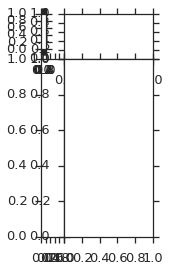

In [230]:
sns.clustermap(genes_of_interest, linewidth=.1,figsize= (2.0,4))
fig = plt.gcf()
fig.savefig(os.path.join(img_dir, "als_specifc_downregulated_genes.svg"))

In [ ]:
sns.clustermap(overlapping_changing_genes, linewidth=.1,figsize= (15,60))